In [1]:
from pycisTopic.clust_vis import find_clusters, run_umap, run_tsne, plot_metadata, plot_topic
import os
import glob
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from IPython.display import Image, display
import math

In [2]:
samples = [x.split('/')[-1].split('__')[0] for x in sorted(glob.glob("cistopic_objects/*singlets.model*topics.pkl"))]
if len(samples) > len(set(samples)):
    print("samples are not unique!")
else:
    print("samples are unique.")

samples are unique.


In [3]:
prediction_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cell_type_classification/*__cell_type_seurat.txt"))}
prediction_path_dict

{'BIO_ddseq_1.FIXEDCELLS': 'cell_type_classification/BIO_ddseq_1.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_2.FIXEDCELLS': 'cell_type_classification/BIO_ddseq_2.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_3.FIXEDCELLS': 'cell_type_classification/BIO_ddseq_3.FIXEDCELLS__cell_type_seurat.txt',
 'BIO_ddseq_4.FIXEDCELLS': 'cell_type_classification/BIO_ddseq_4.FIXEDCELLS__cell_type_seurat.txt',
 'BRO_mtscatac_1.FIXEDCELLS': 'cell_type_classification/BRO_mtscatac_1.FIXEDCELLS__cell_type_seurat.txt',
 'BRO_mtscatac_2.FIXEDCELLS': 'cell_type_classification/BRO_mtscatac_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xmultiome_1.FIXEDCELLS': 'cell_type_classification/CNA_10xmultiome_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xmultiome_2.FIXEDCELLS': 'cell_type_classification/CNA_10xmultiome_2.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_1.FIXEDCELLS': 'cell_type_classification/CNA_10xv11_1.FIXEDCELLS__cell_type_seurat.txt',
 'CNA_10xv11_2.FIXEDCELLS': 'cell_type_classification/CNA_10xv

In [4]:
cto_model_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cistopic_objects/*singlets.model*topics.pkl"))}
cto_model_path_dict

{'BIO_ddseq_1.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.pkl',
 'BIO_ddseq_2.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.pkl',
 'BIO_ddseq_3.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.pkl',
 'BIO_ddseq_4.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.pkl',
 'BRO_mtscatac_1.FIXEDCELLS': 'cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.pkl',
 'BRO_mtscatac_2.FIXEDCELLS': 'cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.pkl',
 'CNA_10xmultiome_1.FIXEDCELLS': 'cistopic_objects/CNA_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.pkl',
 'CNA_10xmultiome_2.FIXEDCELLS': 'cistopic_objects/CNA_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.pkl',
 'CNA_10xv11_1

BIO_ddseq_1.FIXEDCELLS
	cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


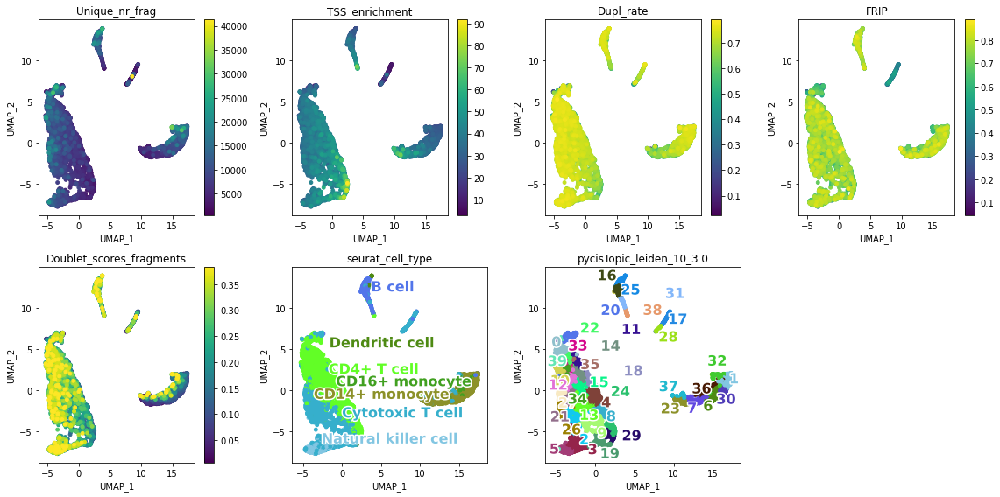

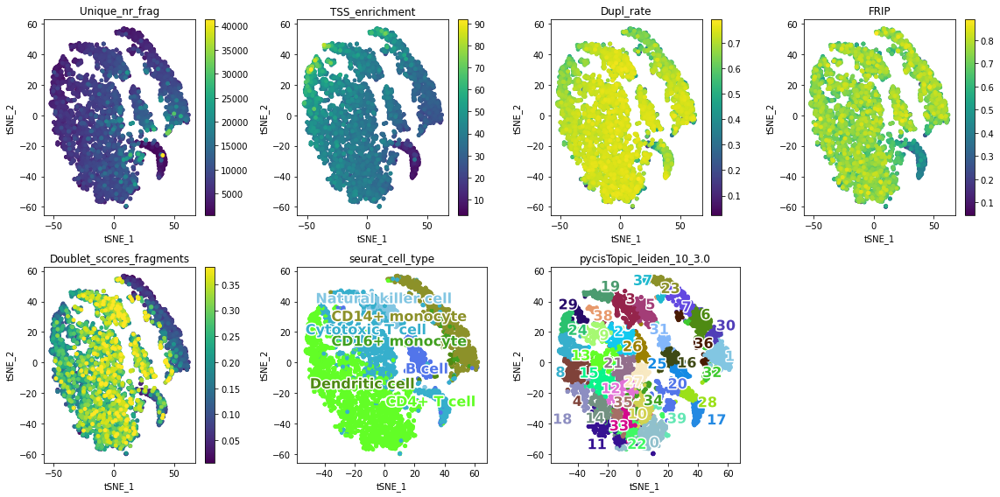

BIO_ddseq_2.FIXEDCELLS
	cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.pkl exists, skipping


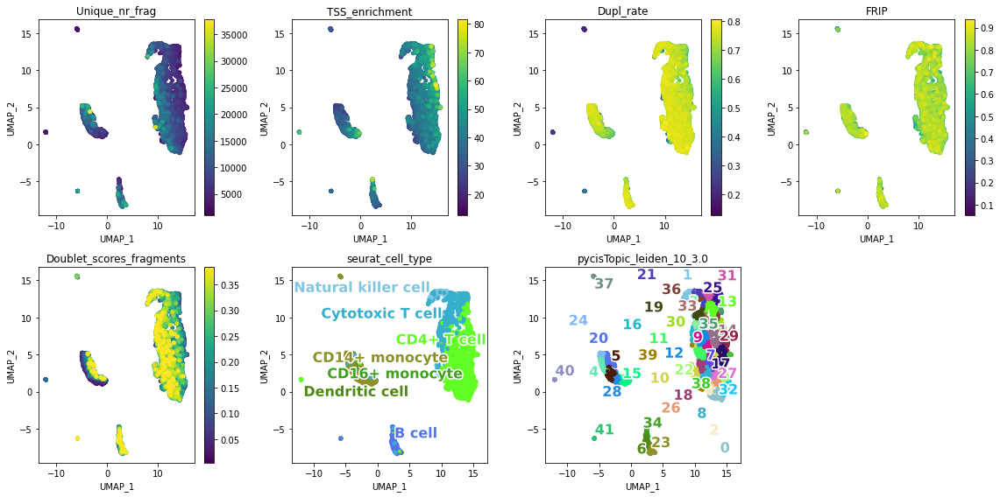

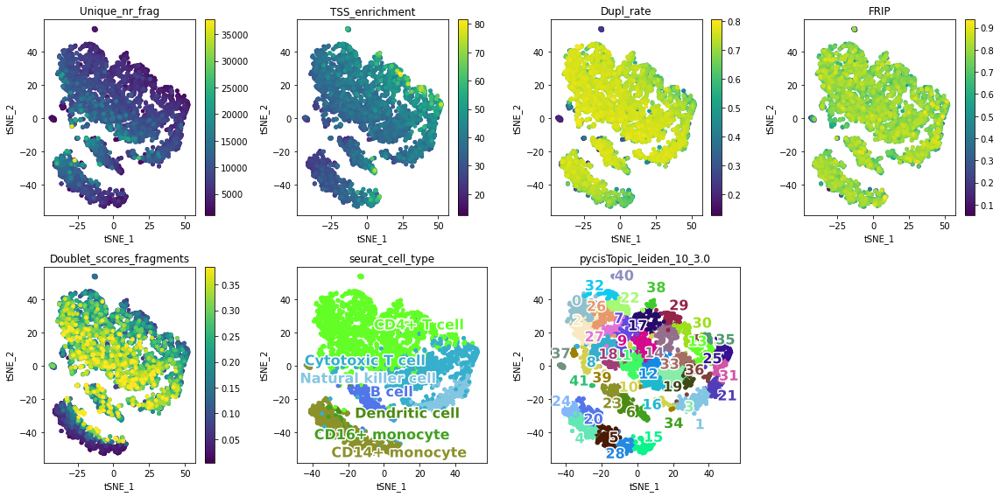

BIO_ddseq_3.FIXEDCELLS
	cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


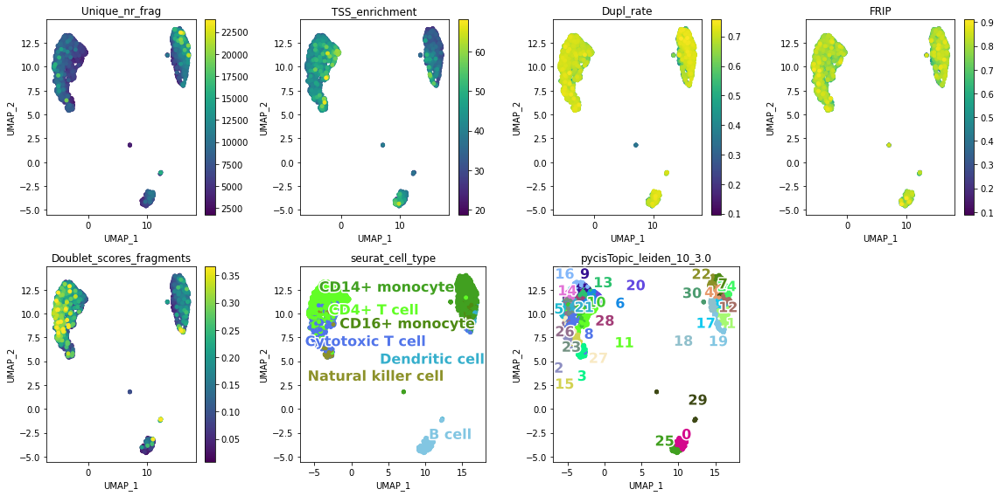

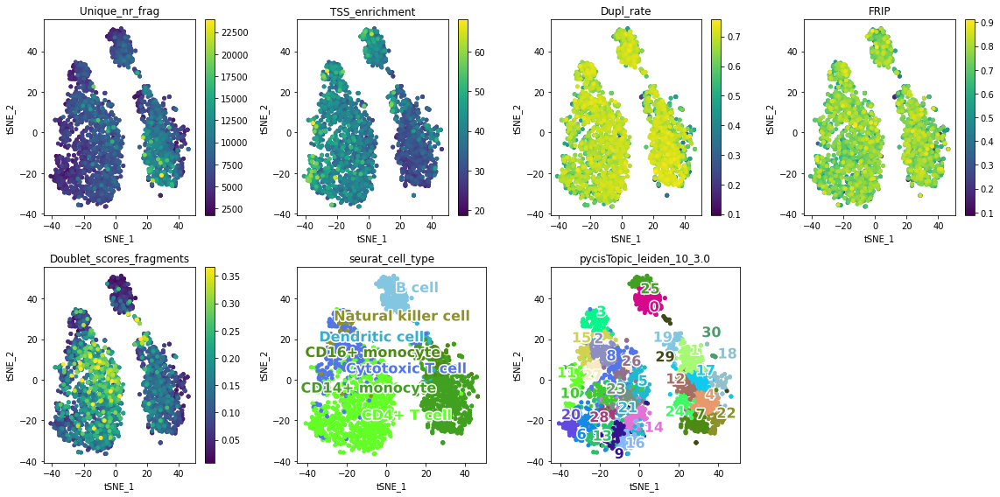

BIO_ddseq_4.FIXEDCELLS
	cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.pkl exists, skipping


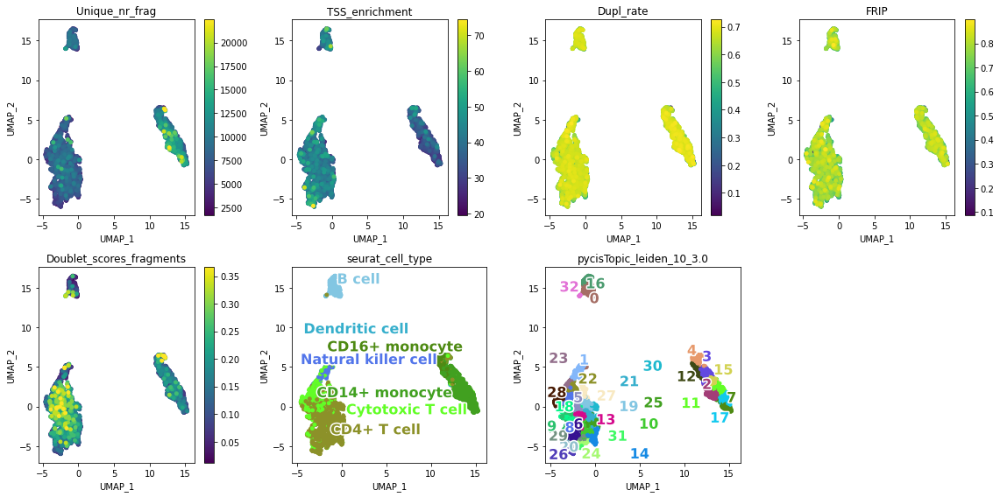

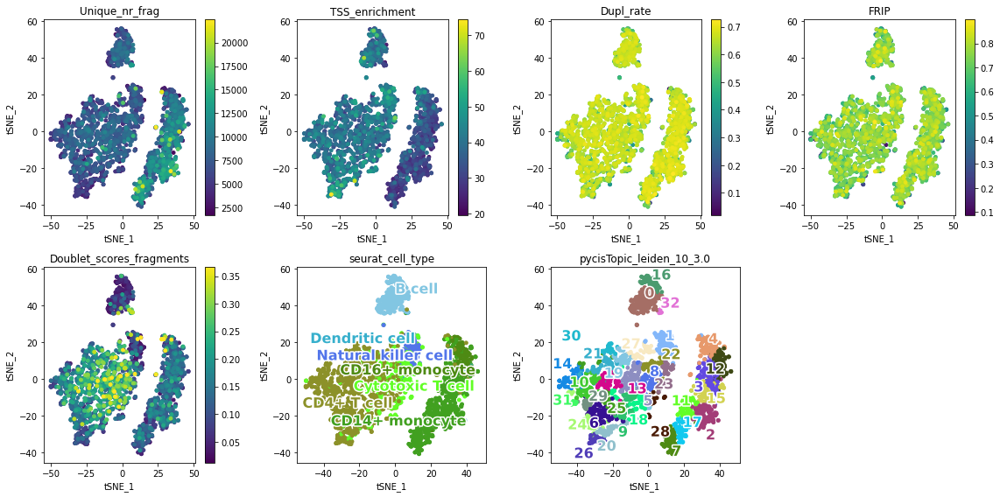

BRO_mtscatac_1.FIXEDCELLS
	cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


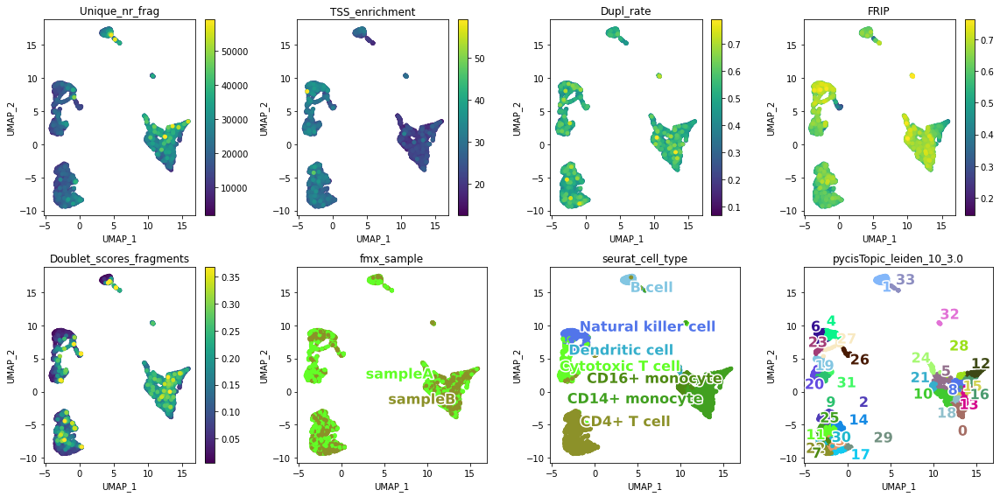

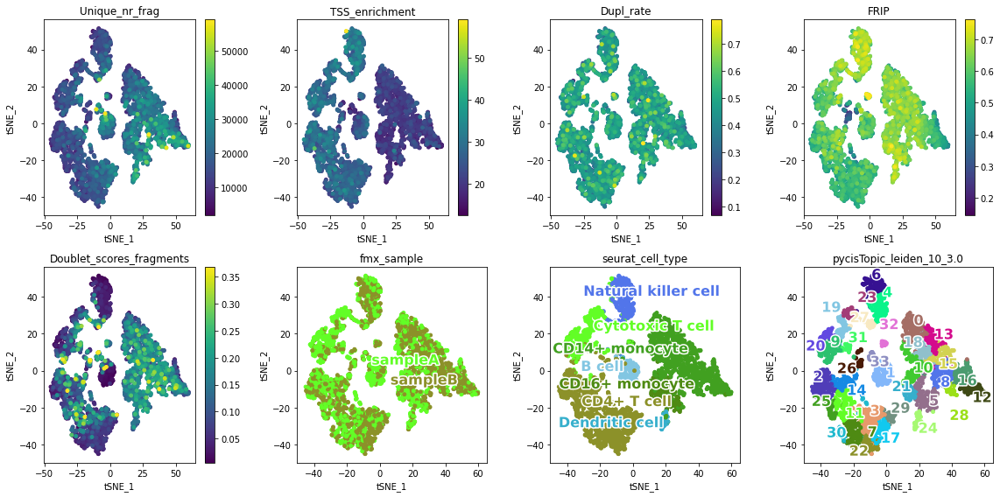

BRO_mtscatac_2.FIXEDCELLS
	cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


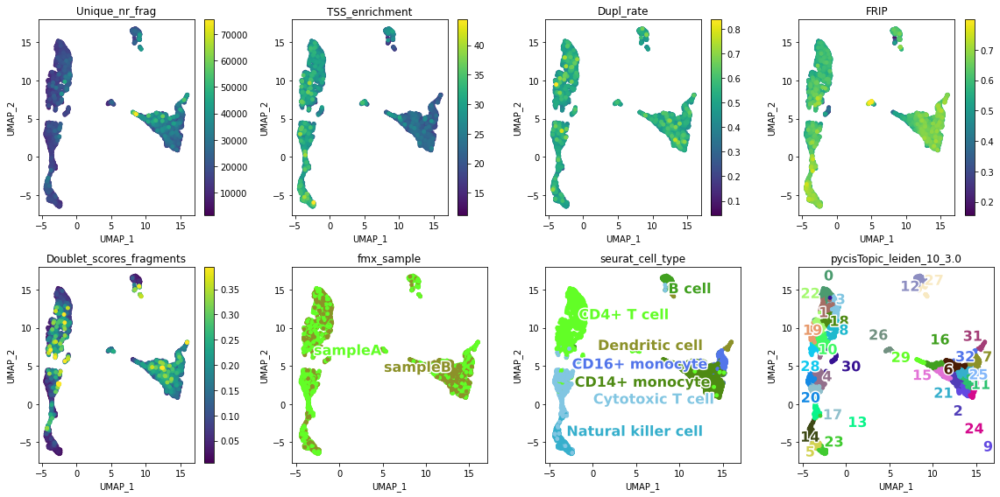

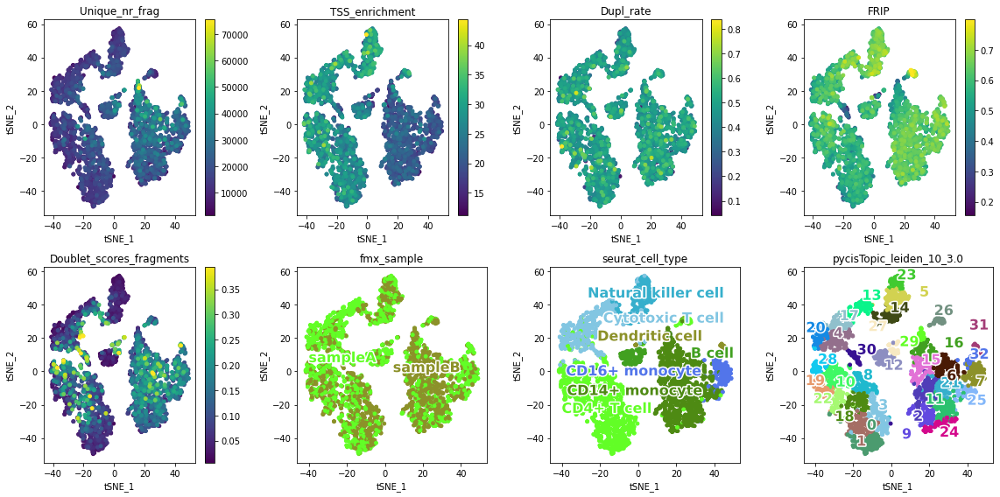

CNA_10xmultiome_1.FIXEDCELLS
	cistopic_objects/CNA_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


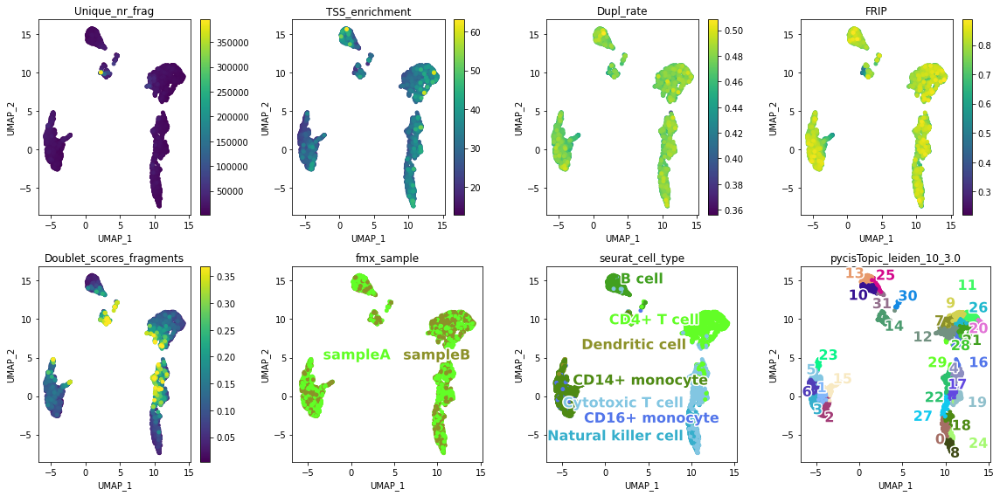

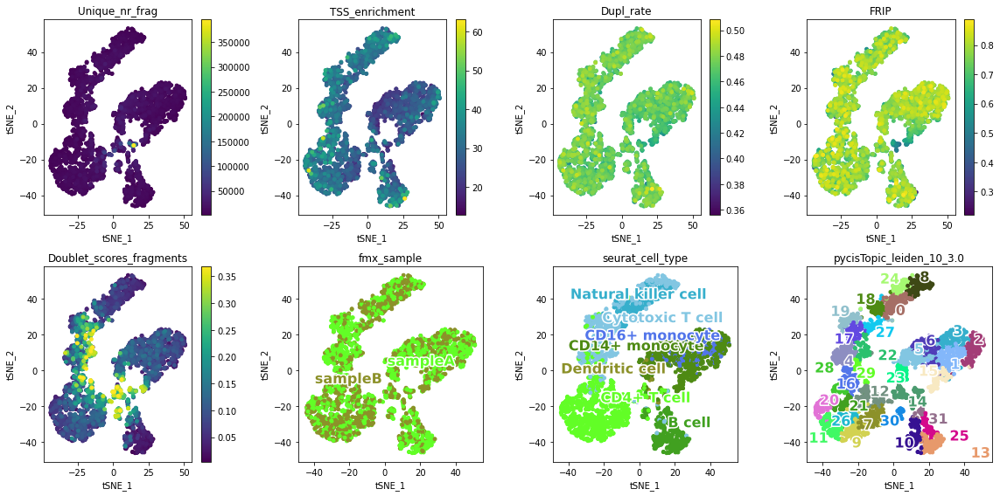

CNA_10xmultiome_2.FIXEDCELLS
	cistopic_objects/CNA_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


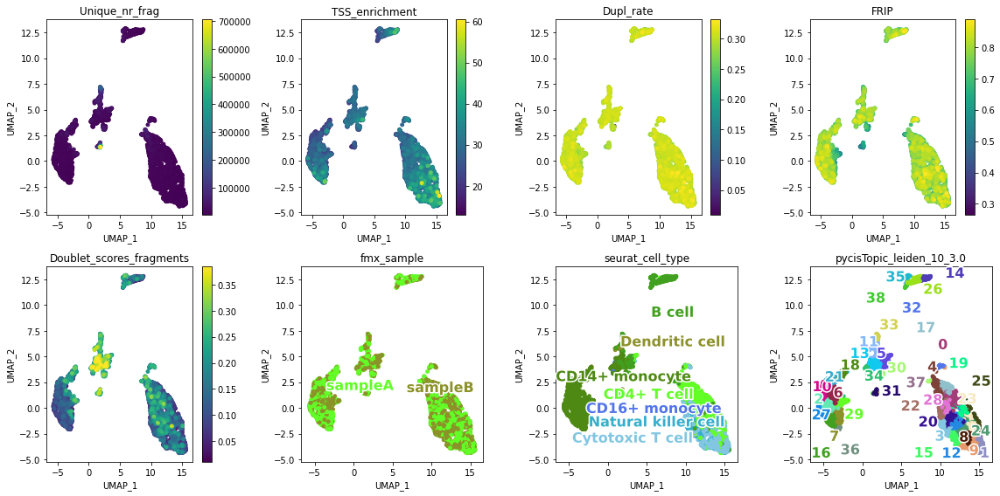

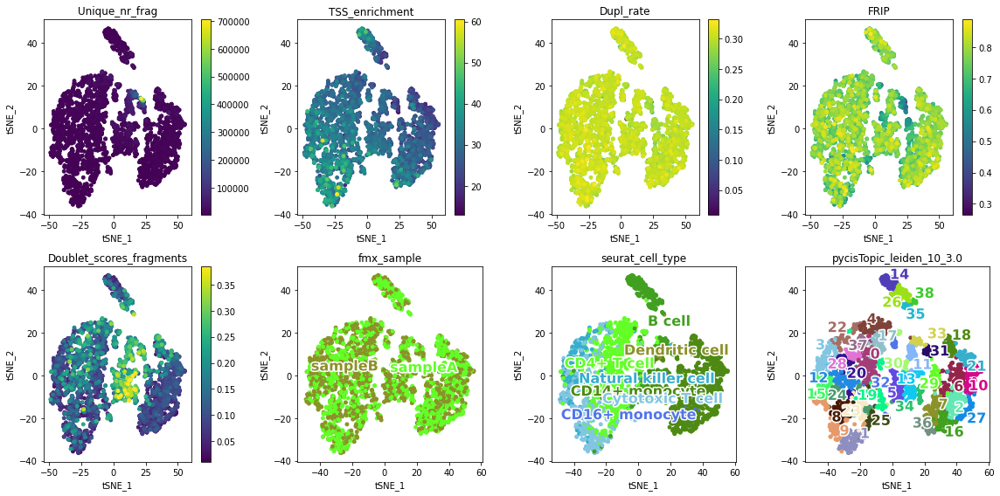

CNA_10xv11_1.FIXEDCELLS
	cistopic_objects/CNA_10xv11_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


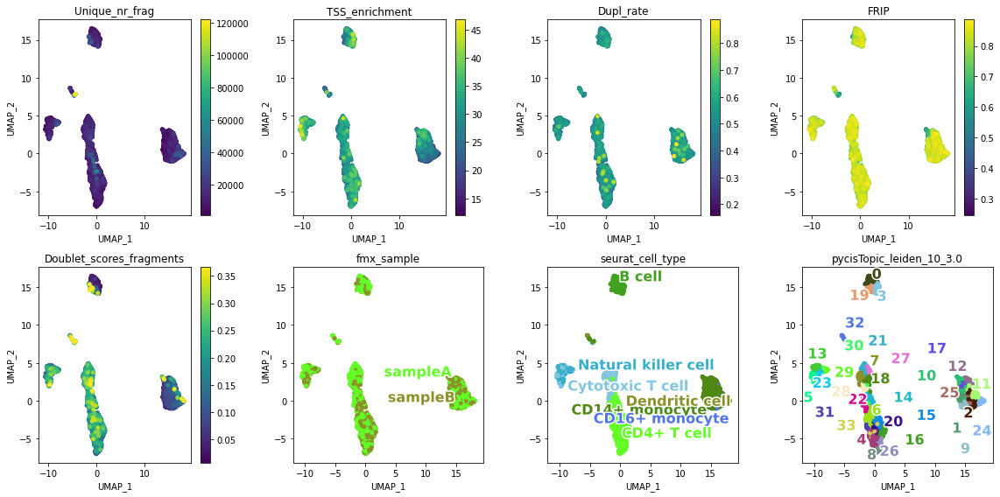

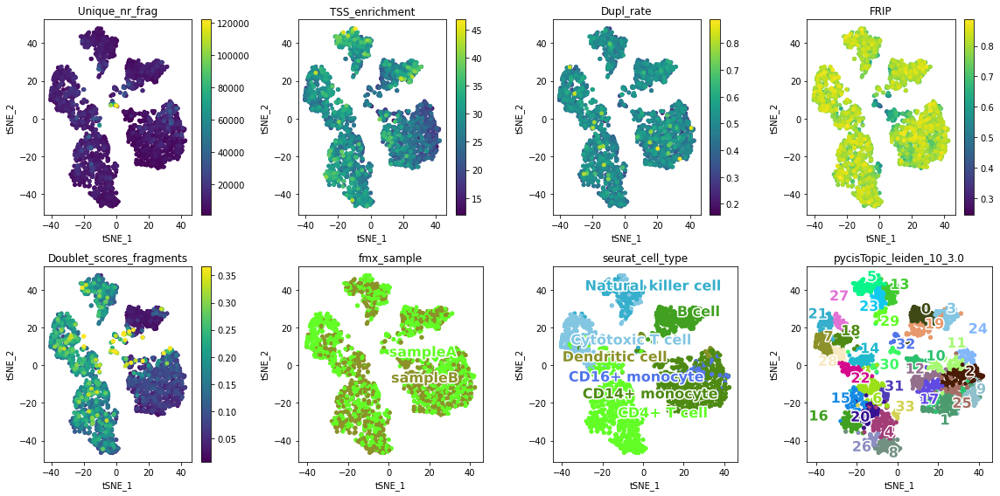

CNA_10xv11_2.FIXEDCELLS
	cistopic_objects/CNA_10xv11_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.pkl exists, skipping


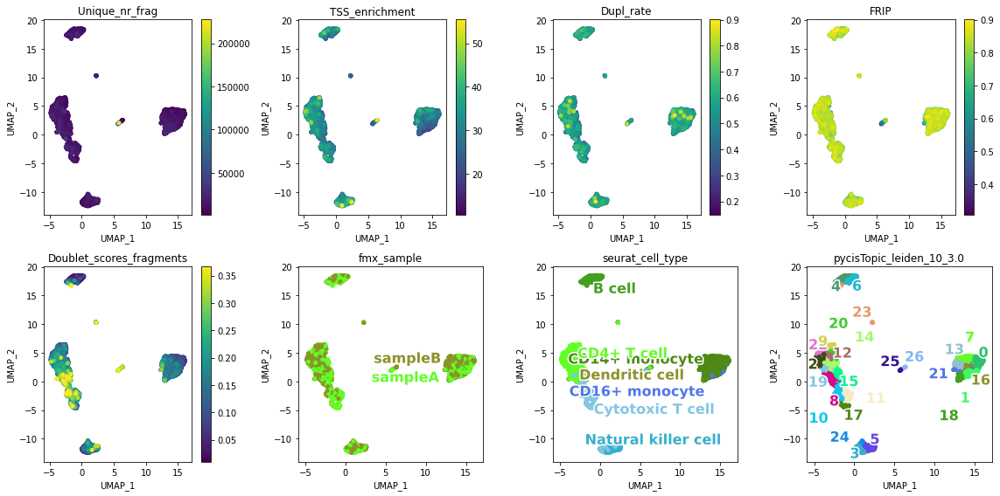

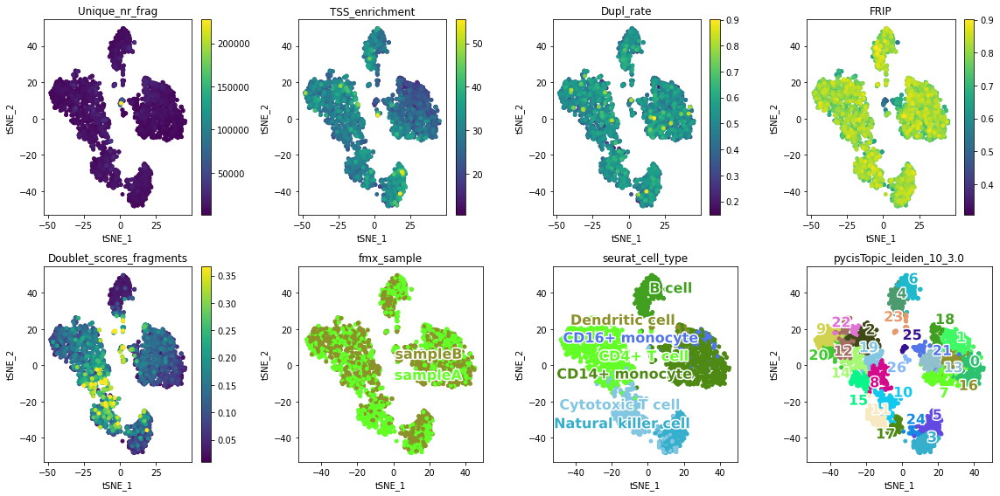

CNA_10xv11_3.FIXEDCELLS
	cistopic_objects/CNA_10xv11_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


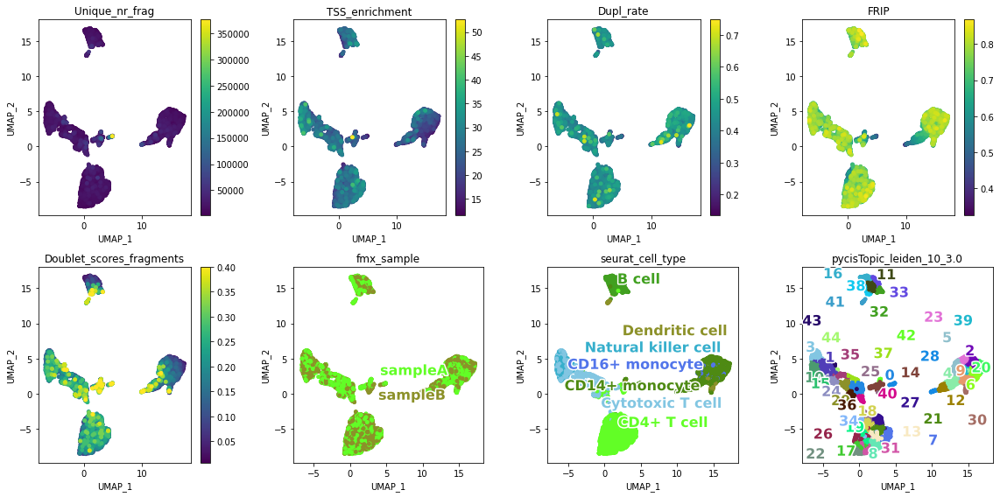

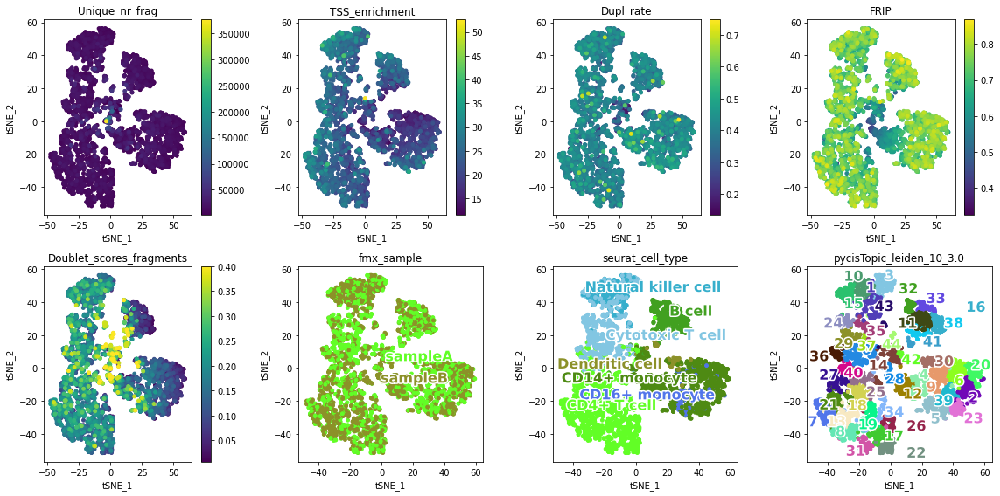

CNA_10xv11_4.FIXEDCELLS
	cistopic_objects/CNA_10xv11_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


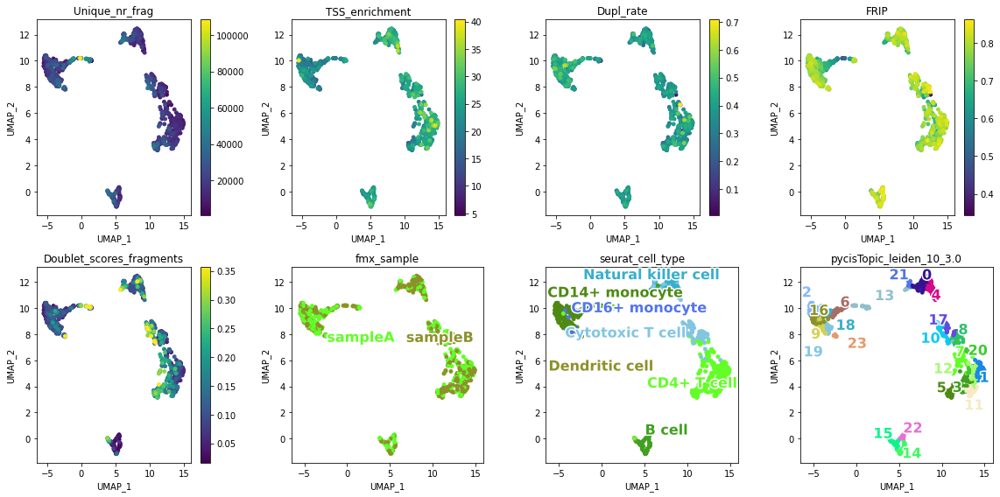

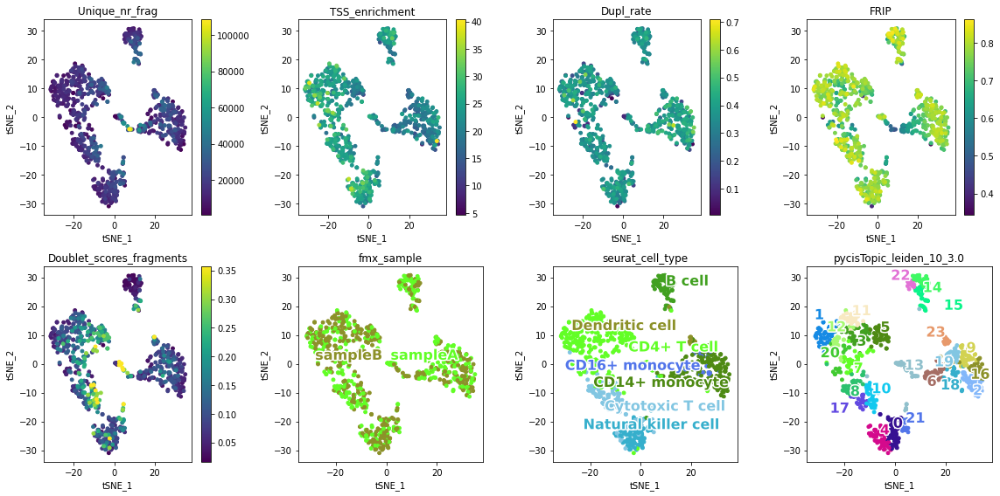

CNA_10xv11_5.FIXEDCELLS
	cistopic_objects/CNA_10xv11_5.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


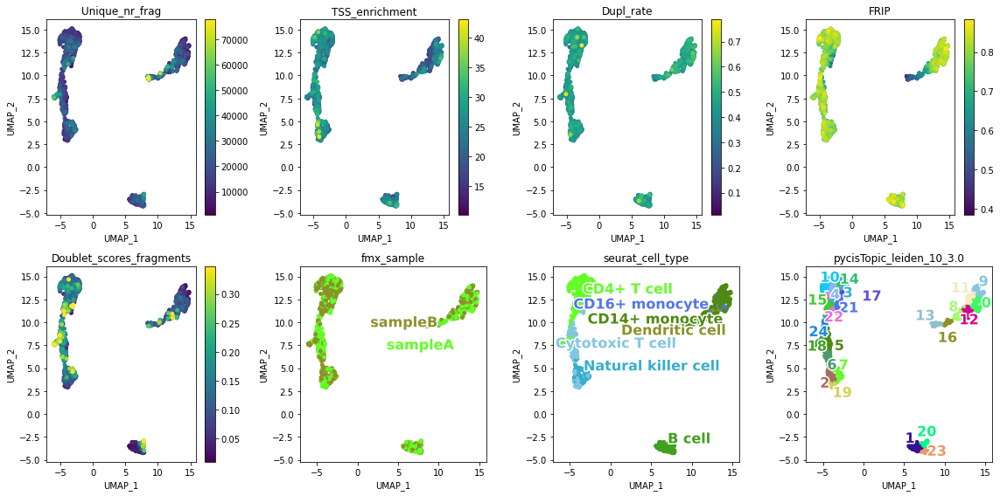

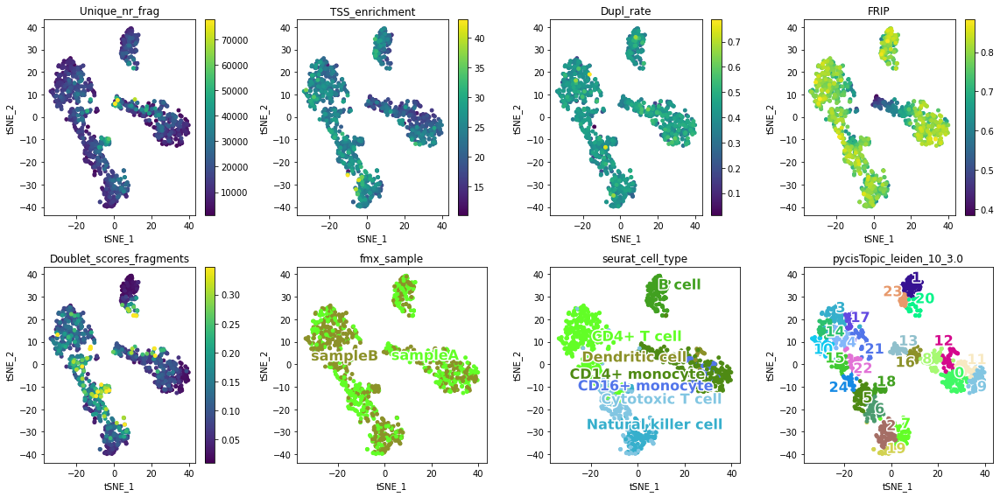

CNA_10xv2_1.FIXEDCELLS
	cistopic_objects/CNA_10xv2_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


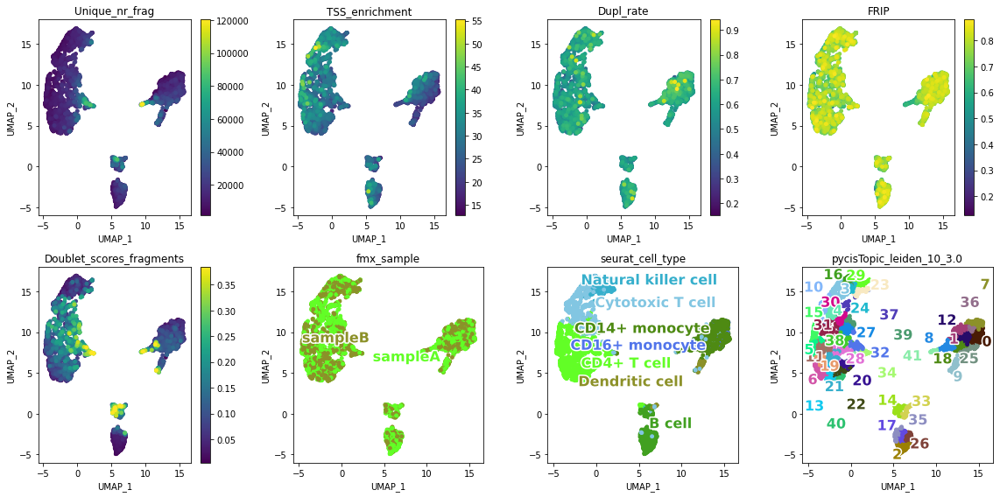

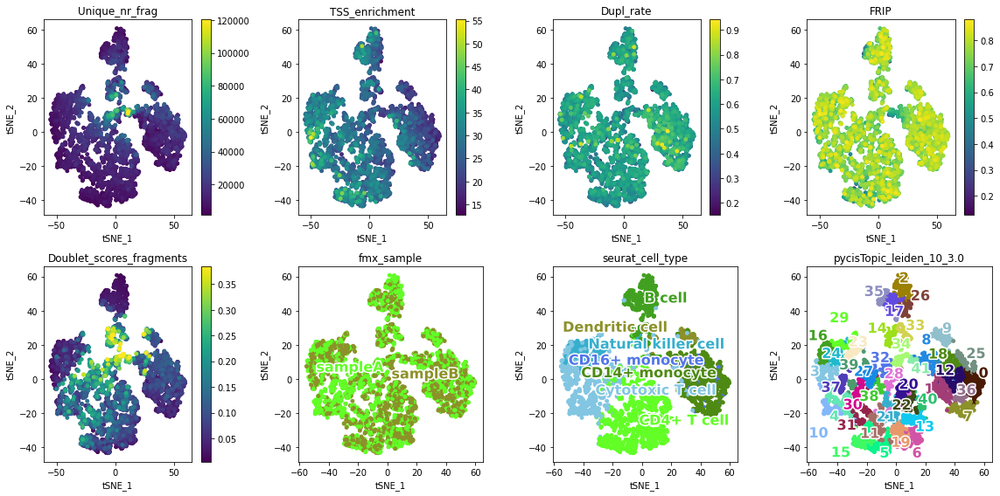

CNA_10xv2_2.FIXEDCELLS
	cistopic_objects/CNA_10xv2_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


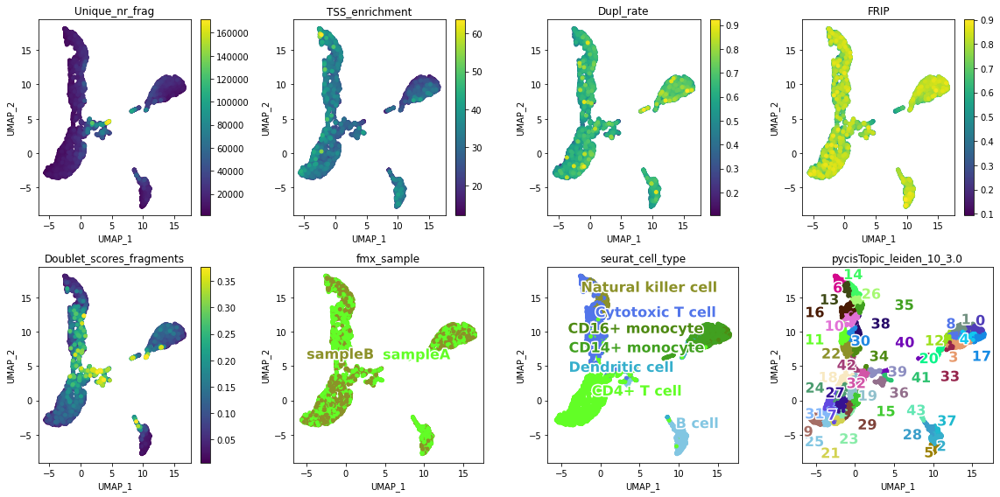

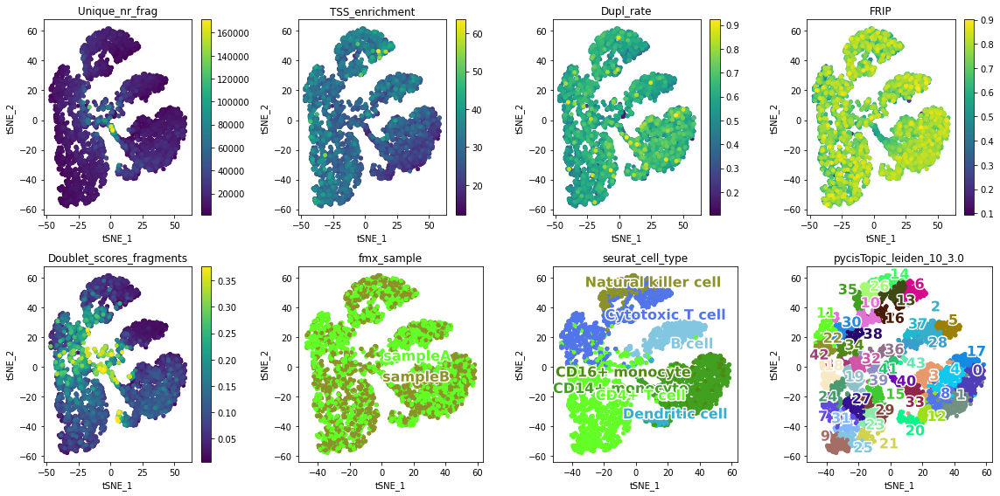

CNA_hydrop_1.FIXEDCELLS
	cistopic_objects/CNA_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


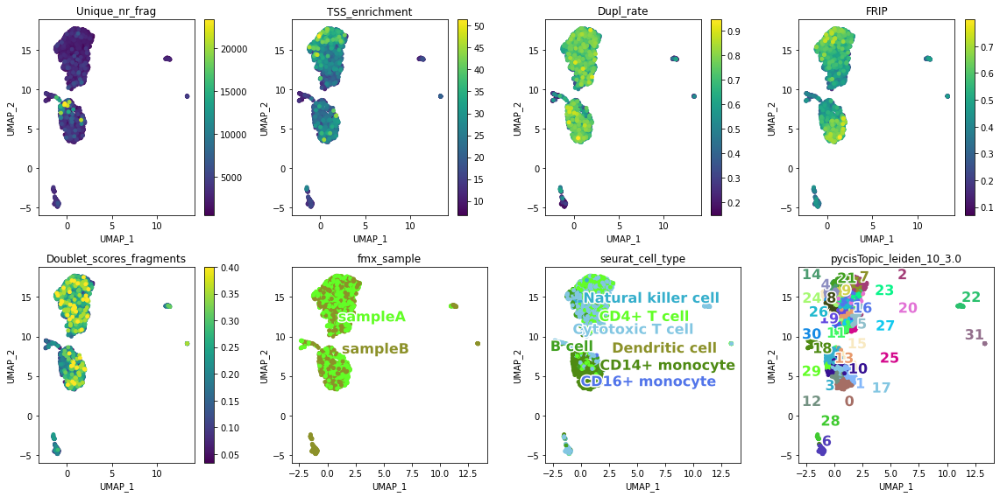

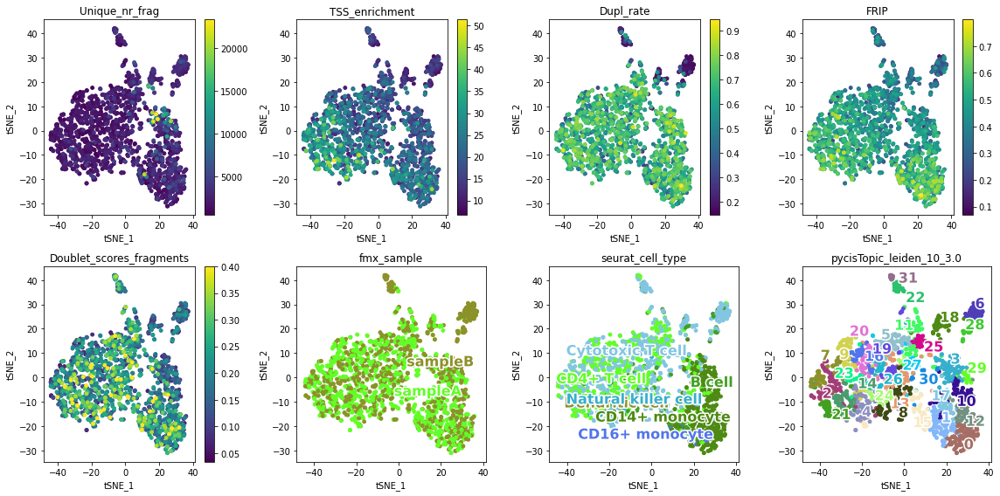

CNA_hydrop_2.FIXEDCELLS
	cistopic_objects/CNA_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


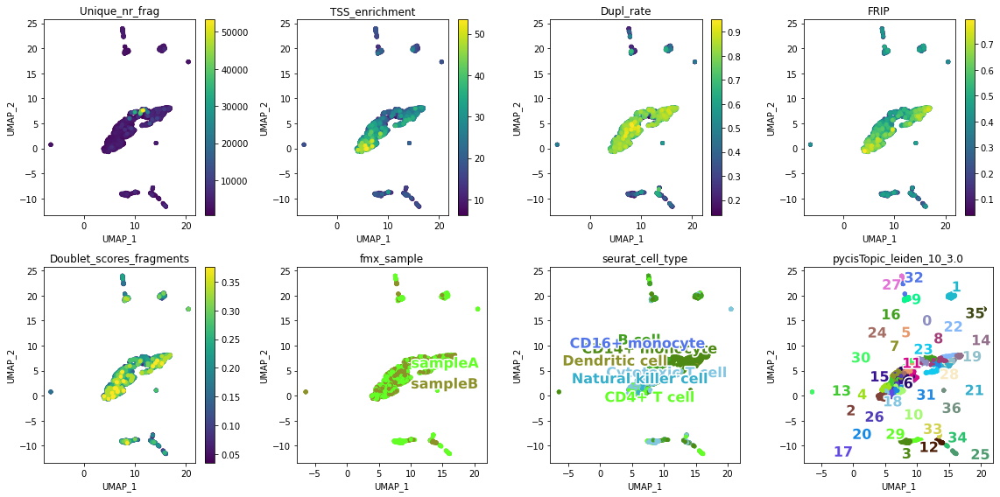

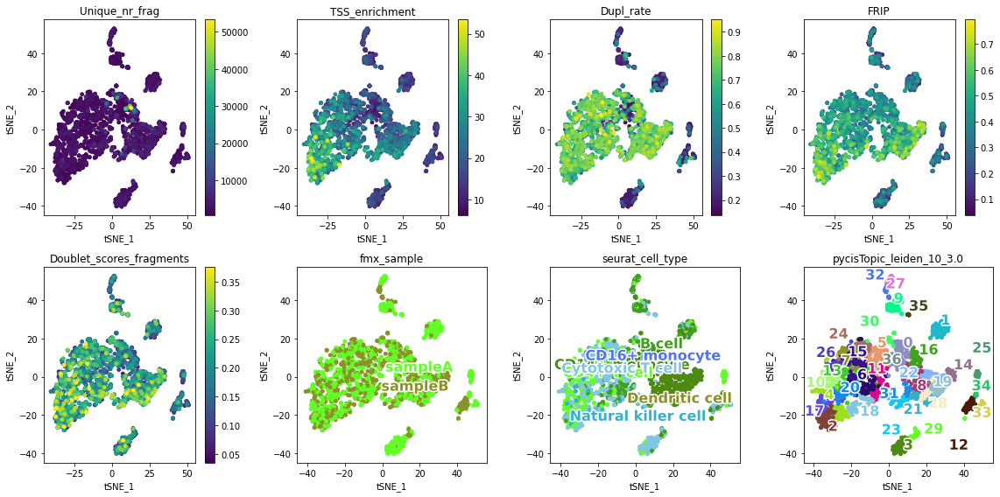

CNA_hydrop_3.FIXEDCELLS
	cistopic_objects/CNA_hydrop_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.pkl exists, skipping


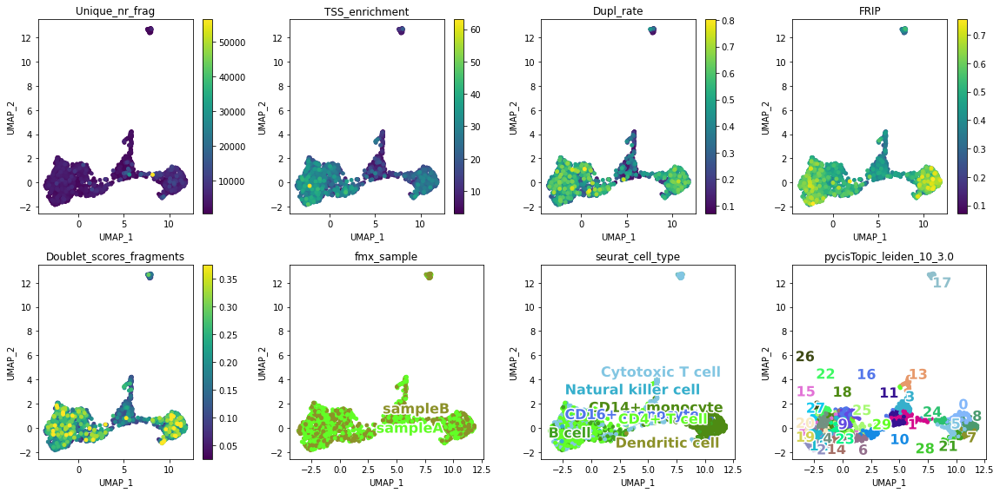

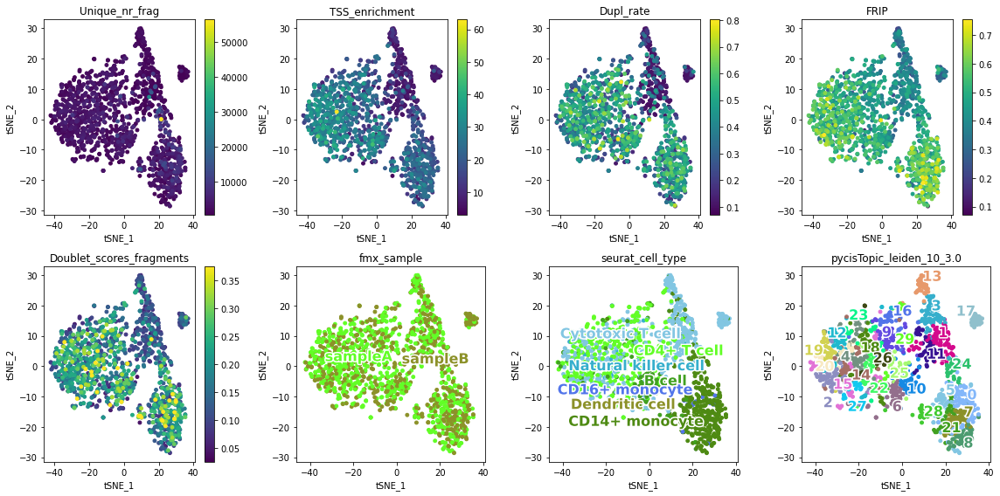

CNA_mtscatac_1.FIXEDCELLS
	cistopic_objects/CNA_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


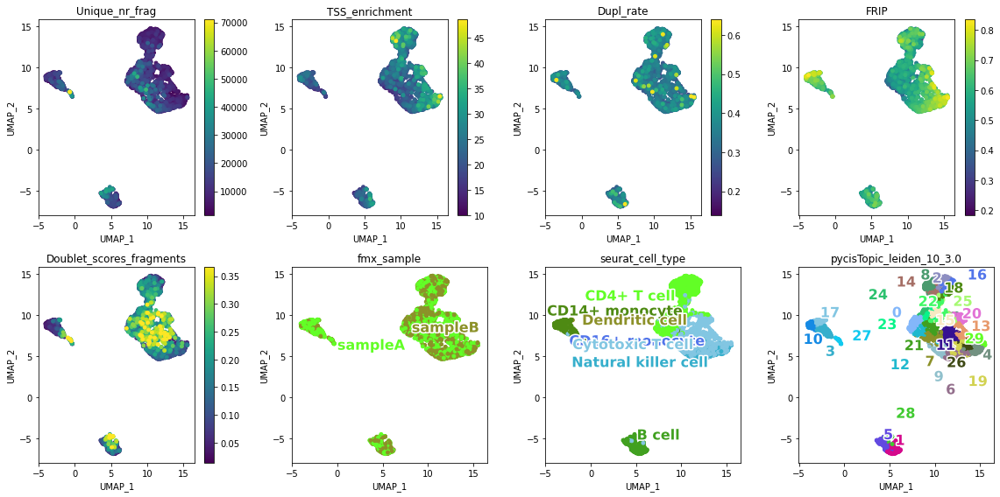

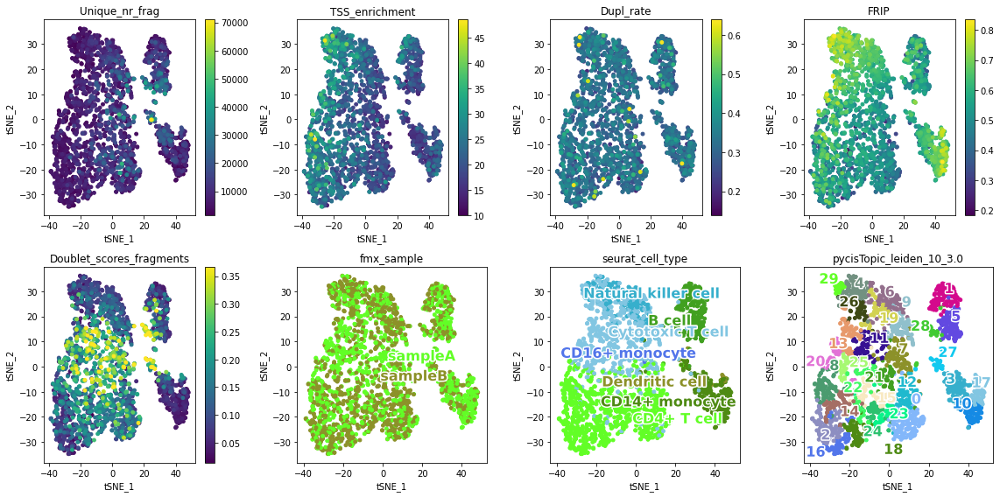

CNA_mtscatac_2.FIXEDCELLS
	cistopic_objects/CNA_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.pkl exists, skipping


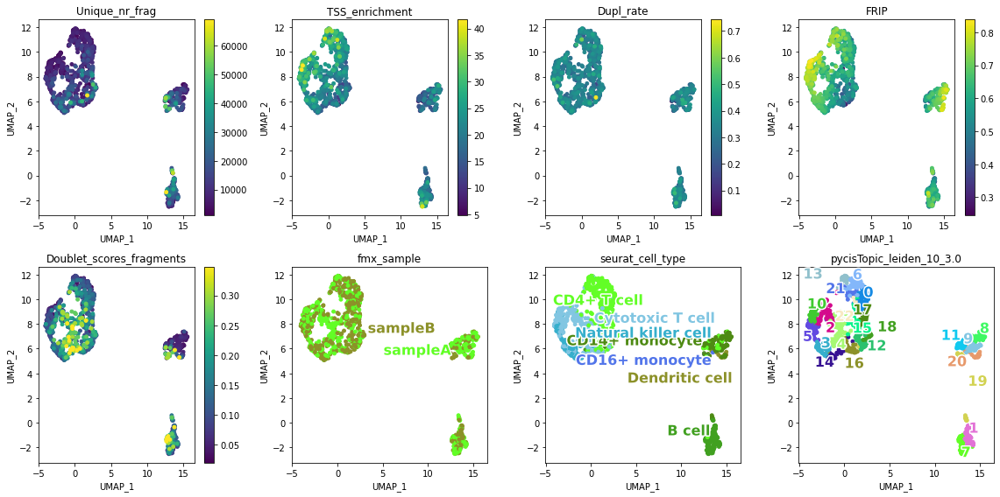

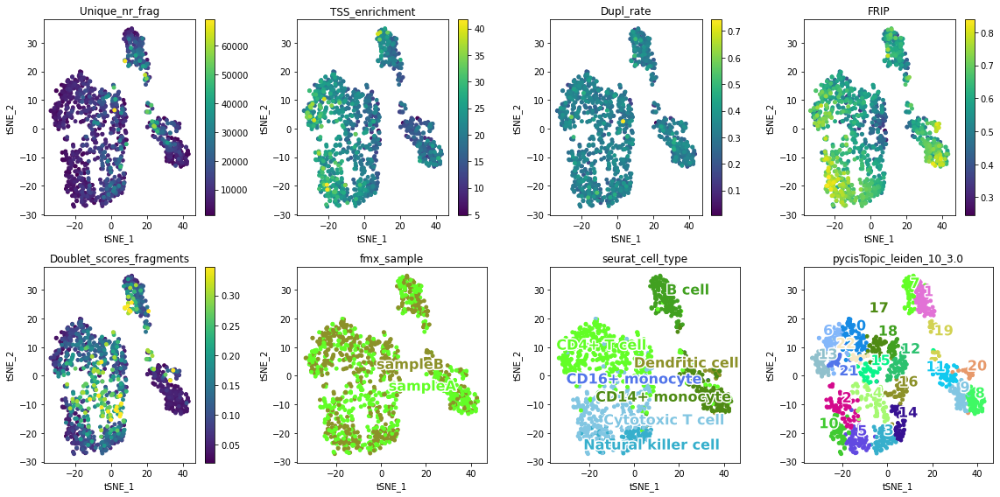

EPF_hydrop_1.FIXEDCELLS
	cistopic_objects/EPF_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


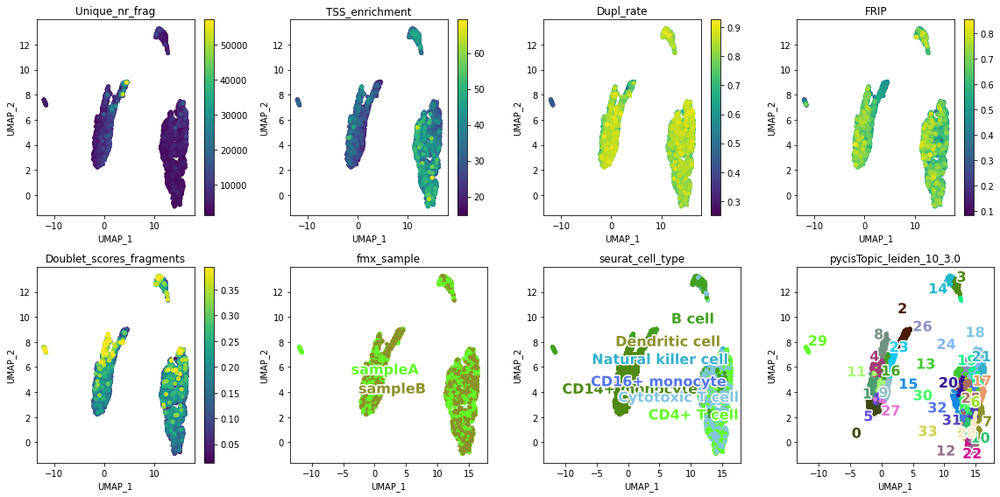

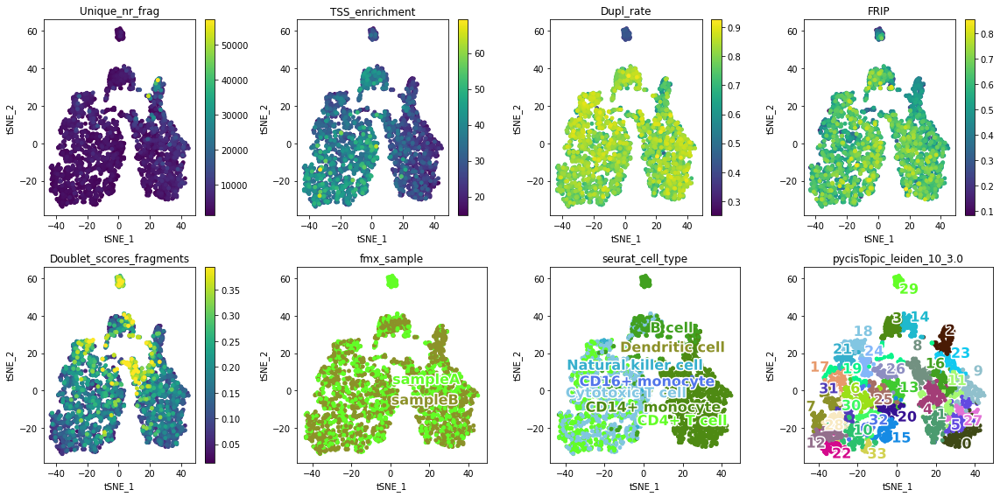

EPF_hydrop_2.FIXEDCELLS
	cistopic_objects/EPF_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.pkl exists, skipping


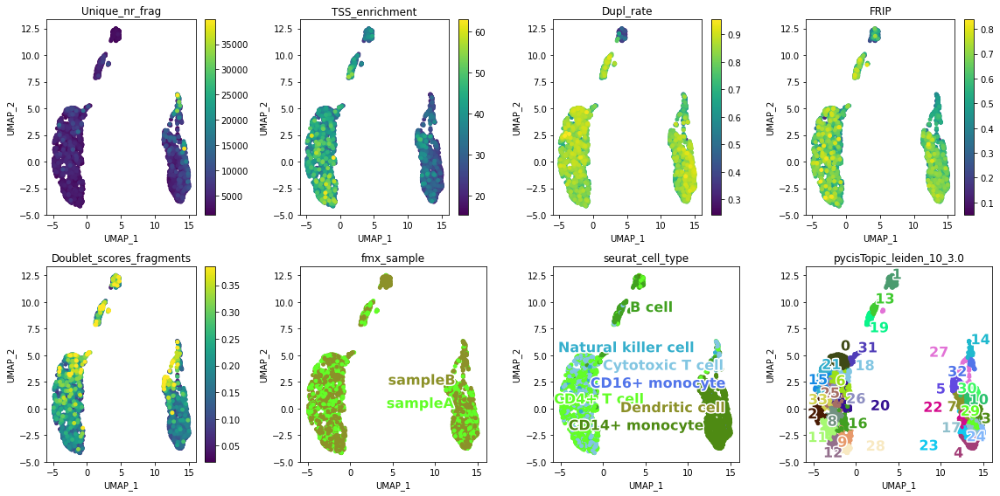

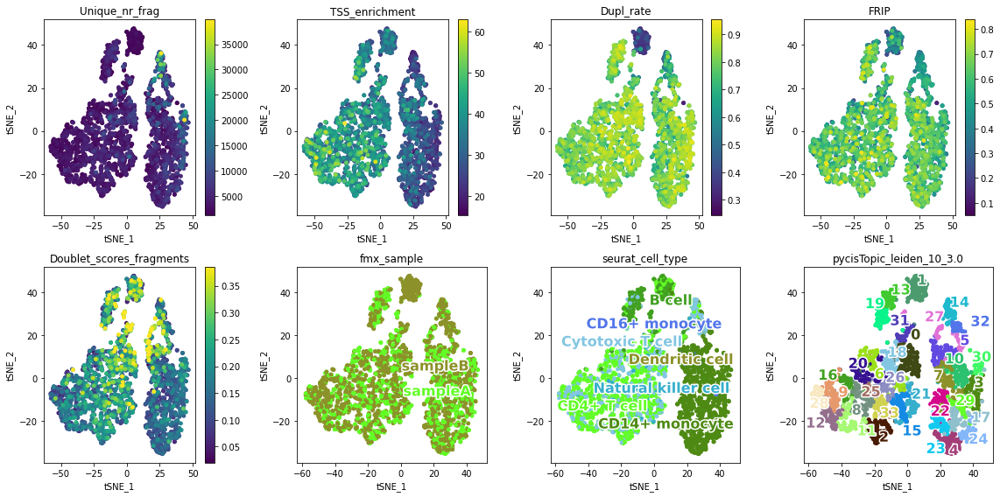

EPF_hydrop_3.FIXEDCELLS
	cistopic_objects/EPF_hydrop_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


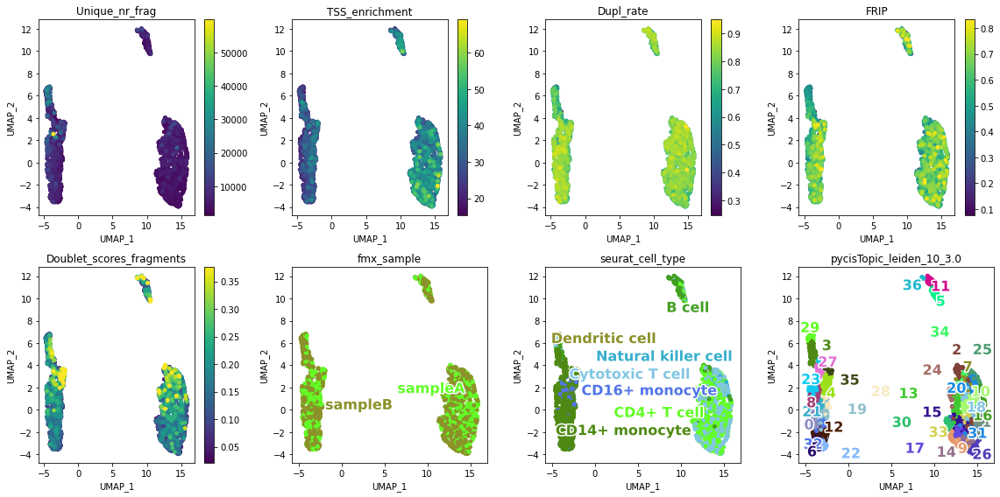

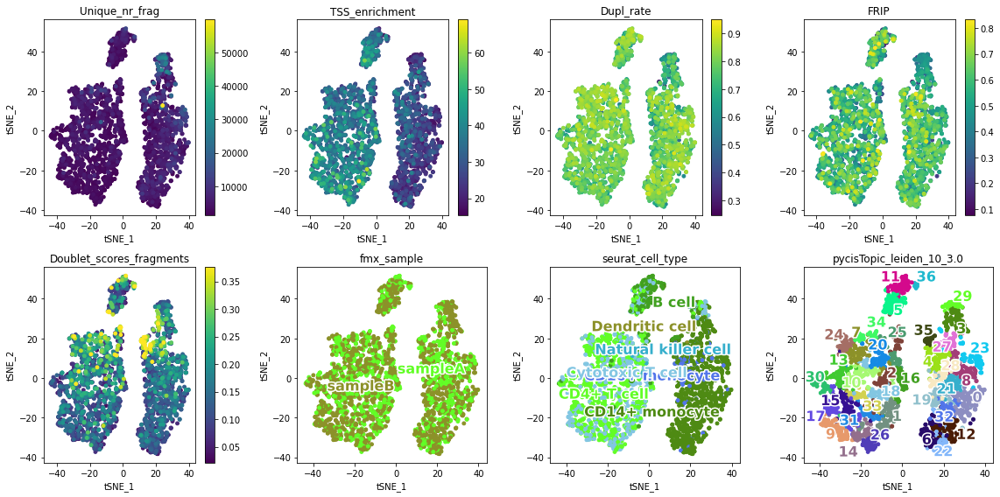

EPF_hydrop_4.FIXEDCELLS
	cistopic_objects/EPF_hydrop_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.pkl exists, skipping


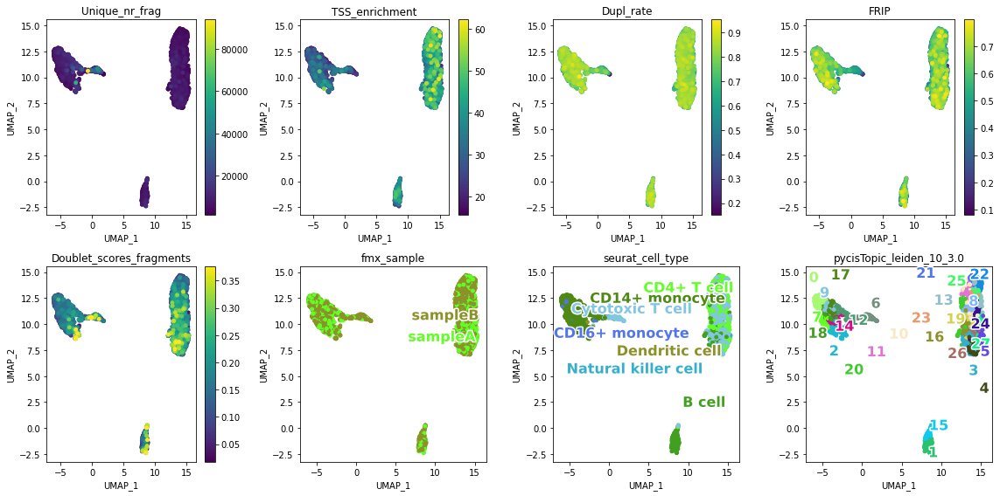

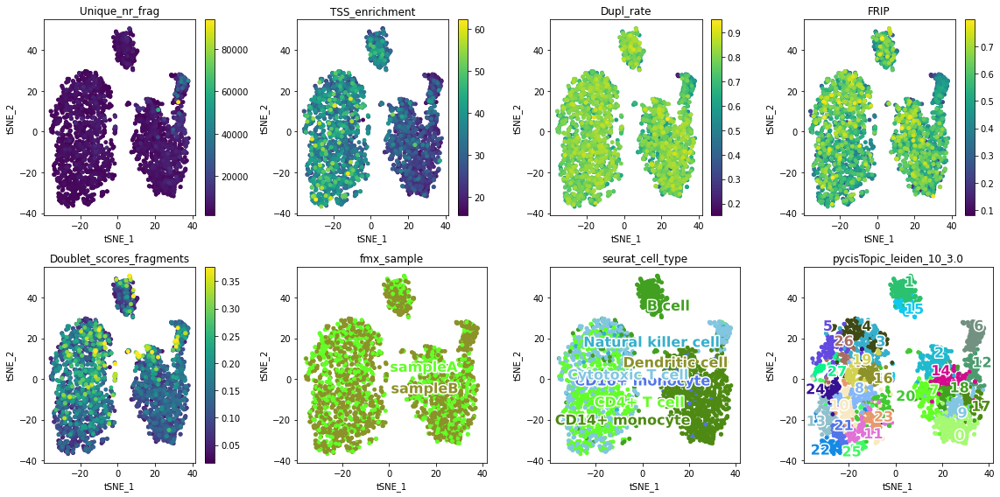

HAR_ddseq_1.FIXEDCELLS
	cistopic_objects/HAR_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_17topics.dimreduc.pkl exists, skipping


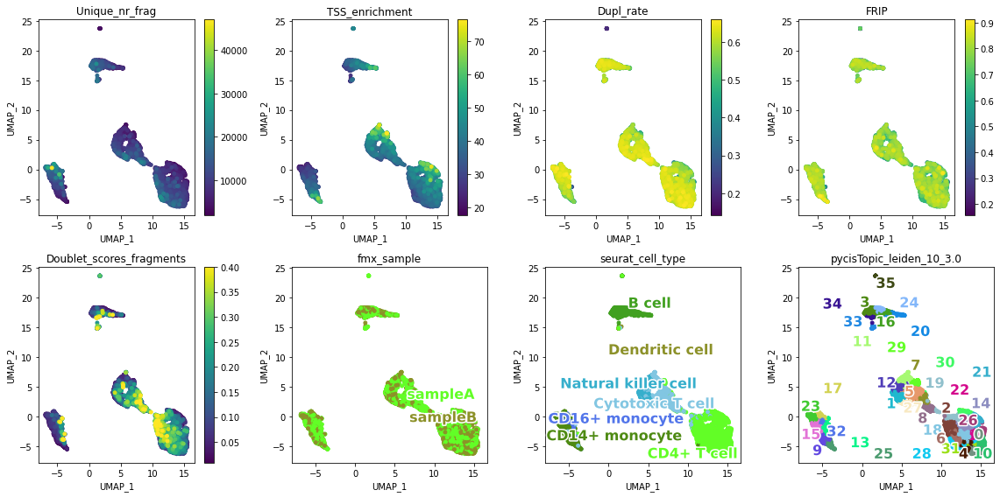

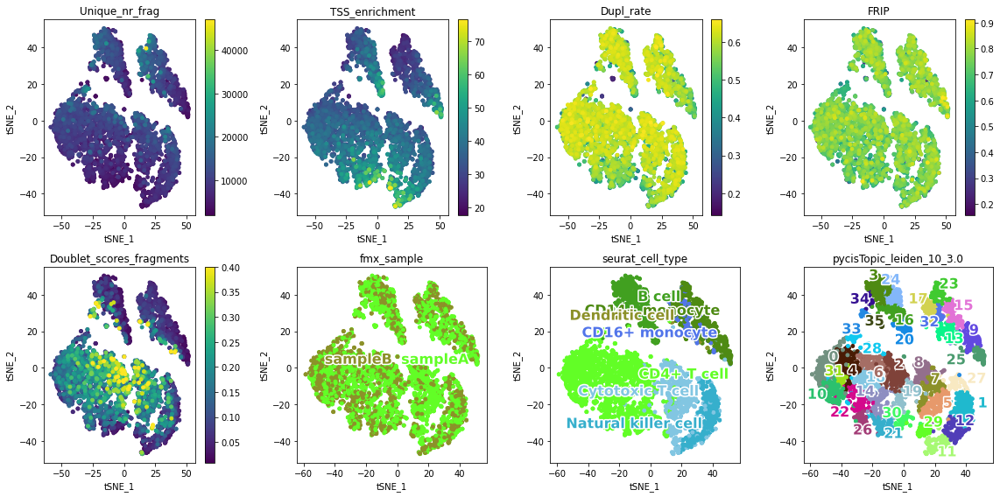

HAR_ddseq_2.FIXEDCELLS
	cistopic_objects/HAR_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


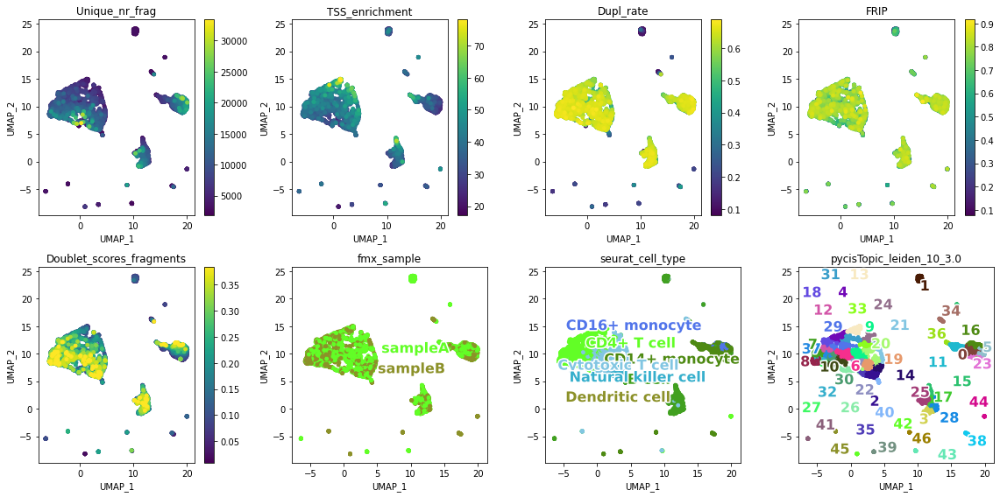

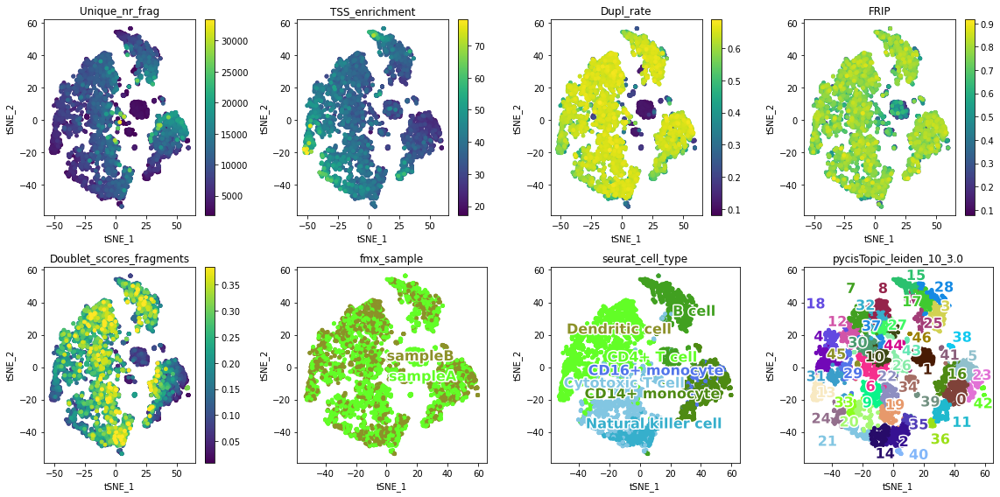

MDC_mtscatac_1.FIXEDCELLS
	cistopic_objects/MDC_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


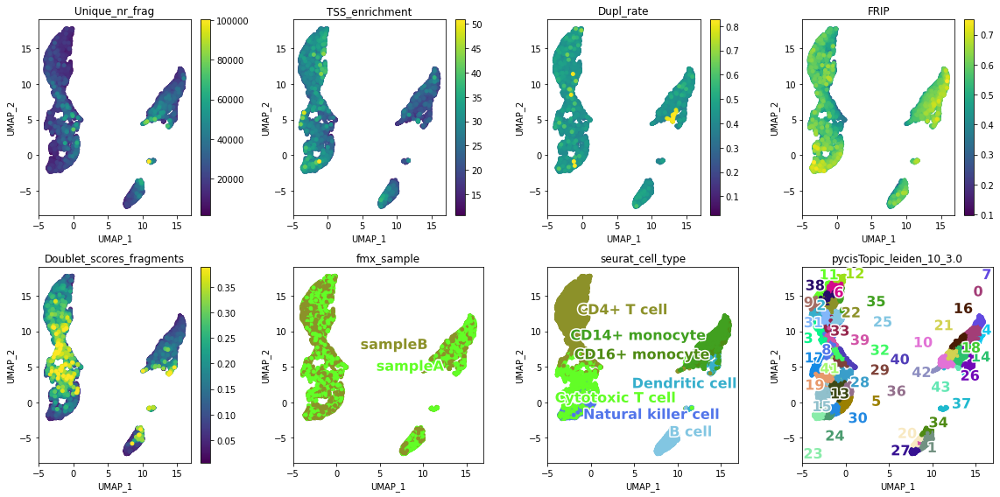

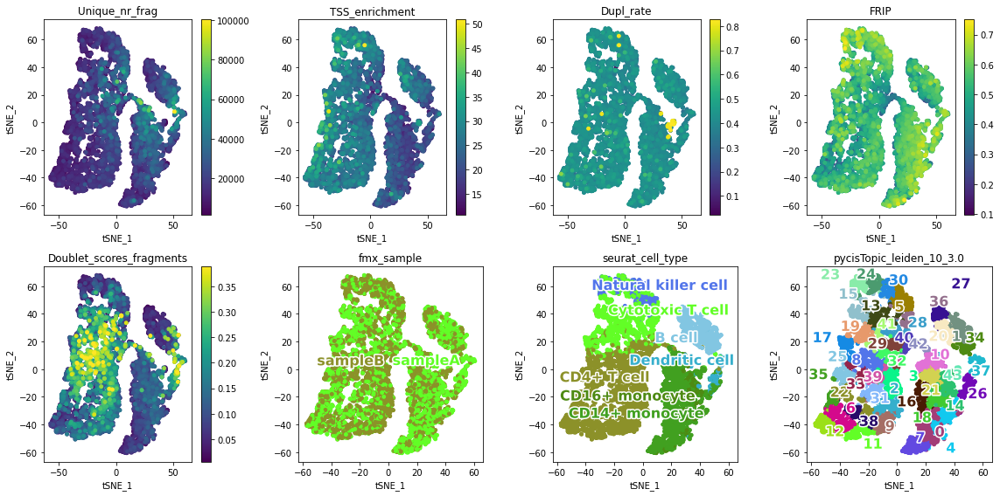

MDC_mtscatac_2.FIXEDCELLS
	cistopic_objects/MDC_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


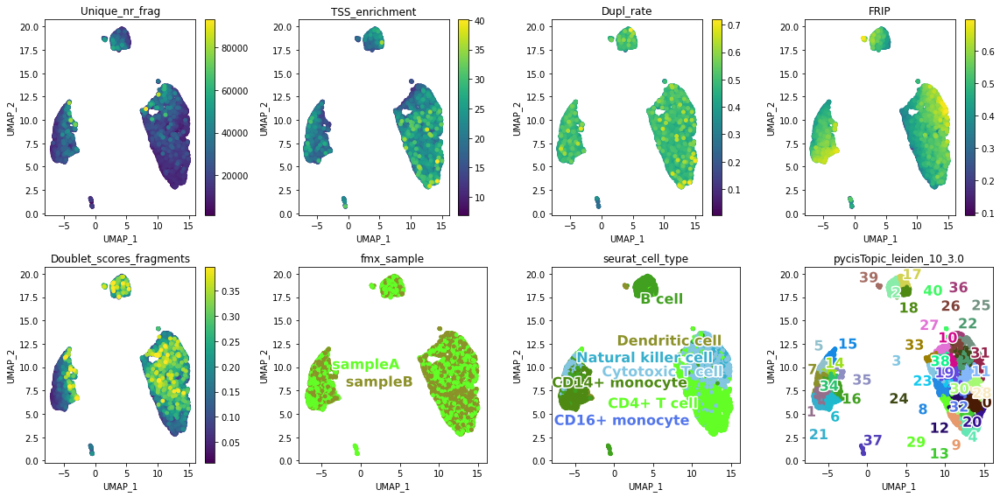

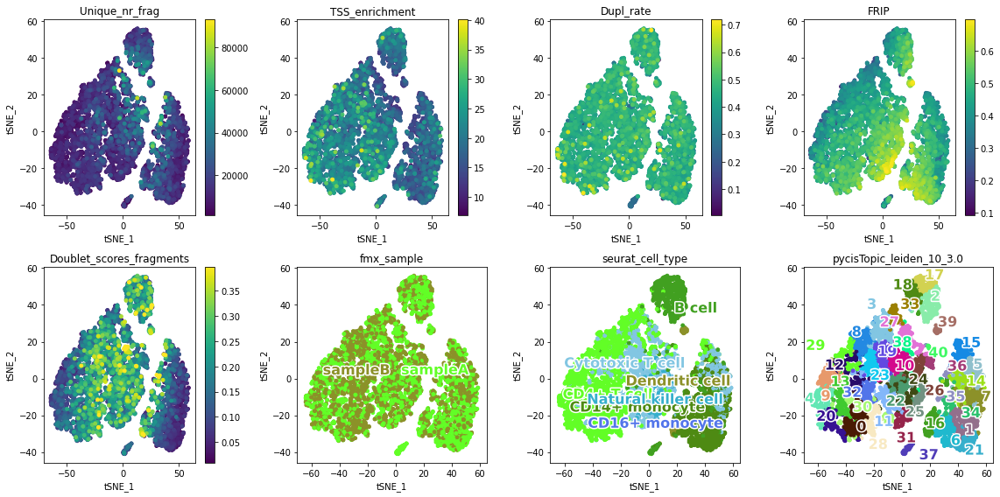

OHS_s3atac_1.FIXEDCELLS
	cistopic_objects/OHS_s3atac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


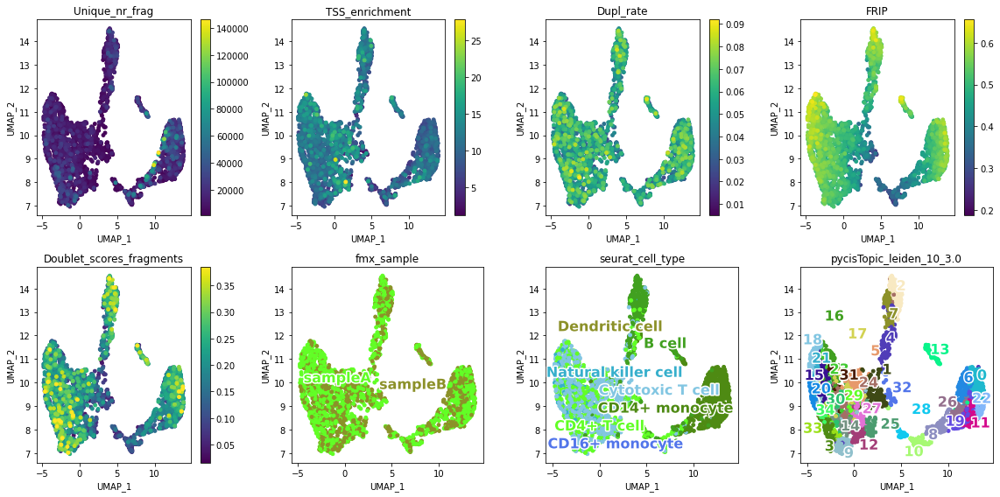

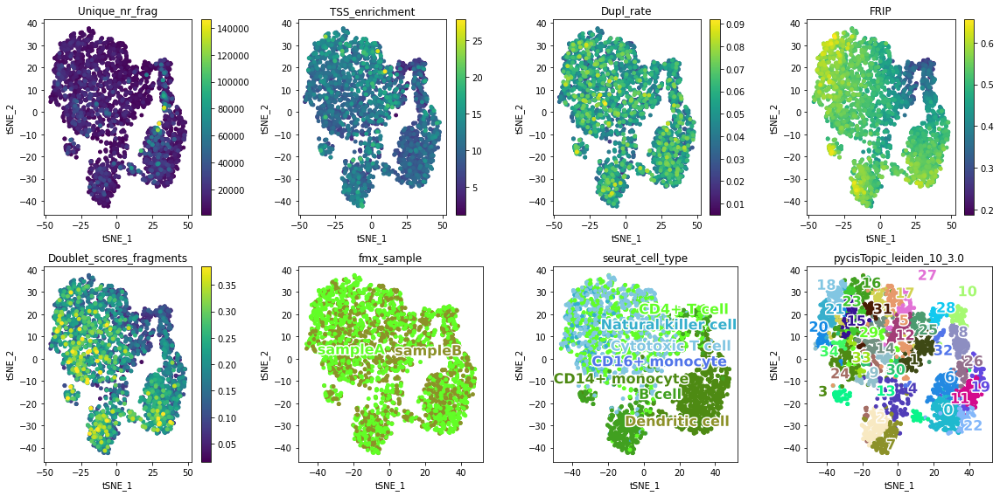

OHS_s3atac_2.FIXEDCELLS
	cistopic_objects/OHS_s3atac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


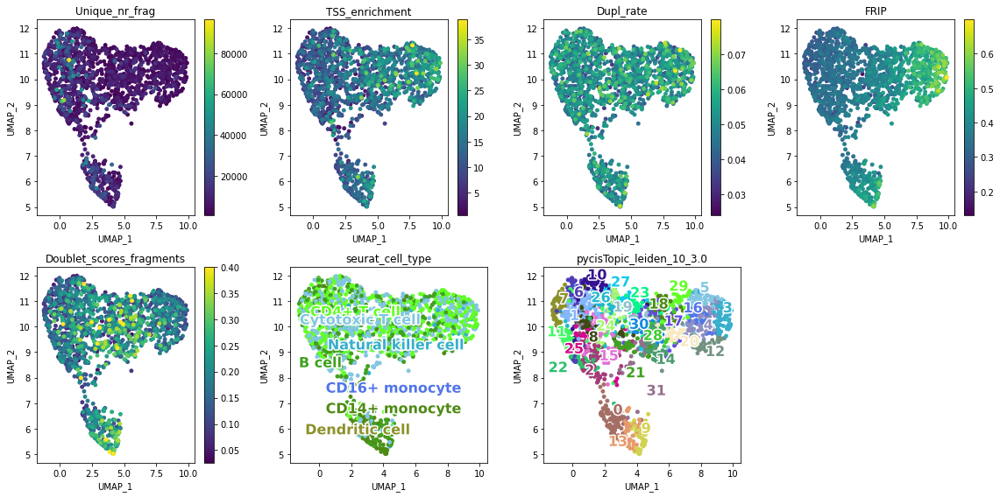

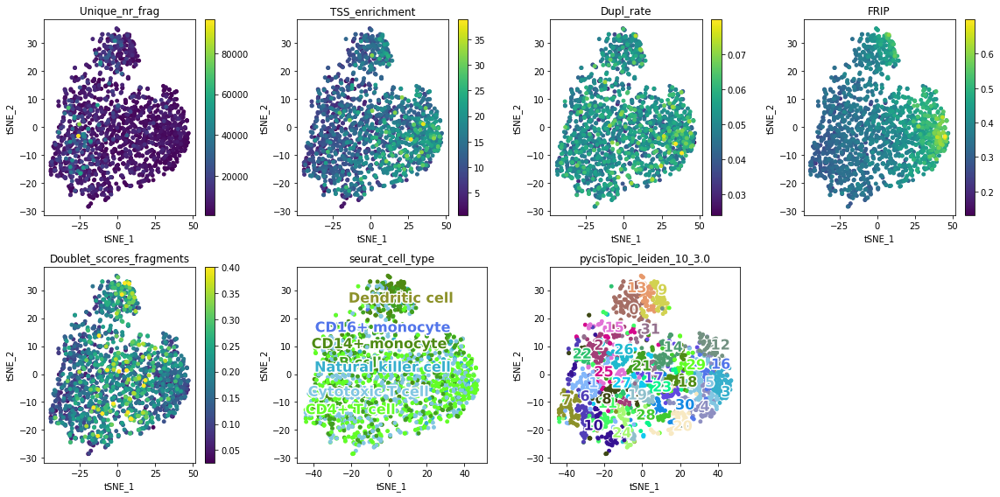

SAN_10xmultiome_1.FIXEDCELLS
	cistopic_objects/SAN_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


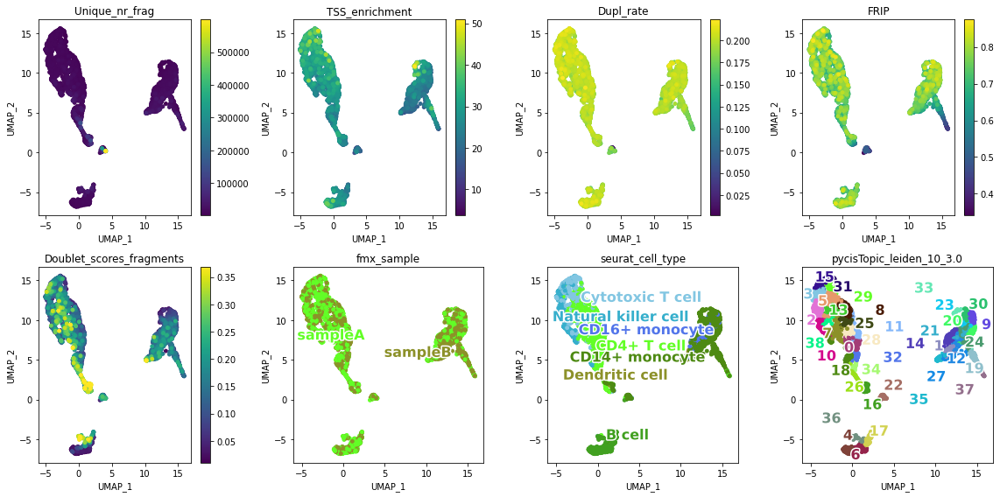

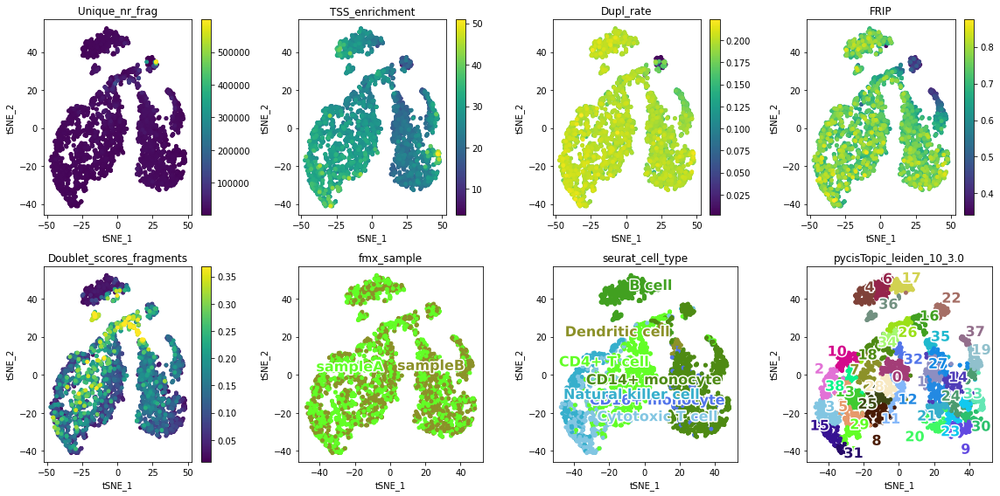

SAN_10xmultiome_2.FIXEDCELLS
	cistopic_objects/SAN_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


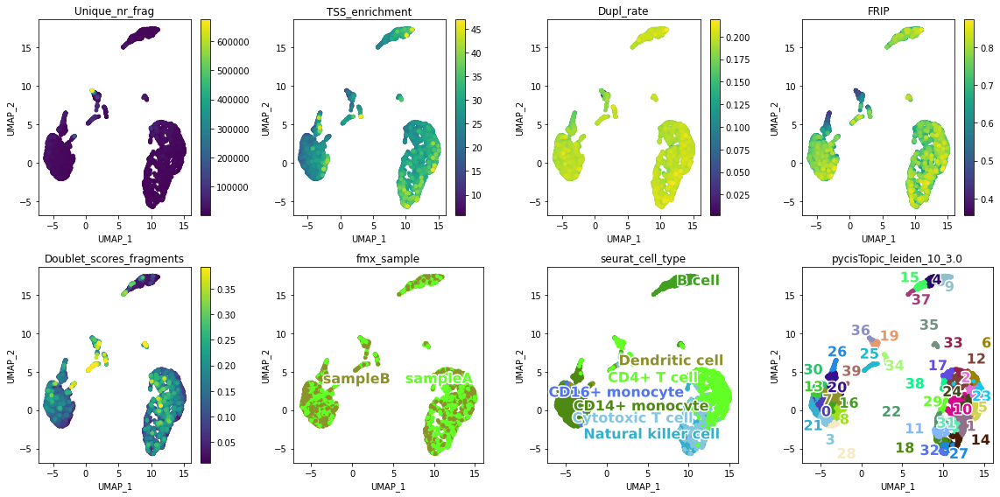

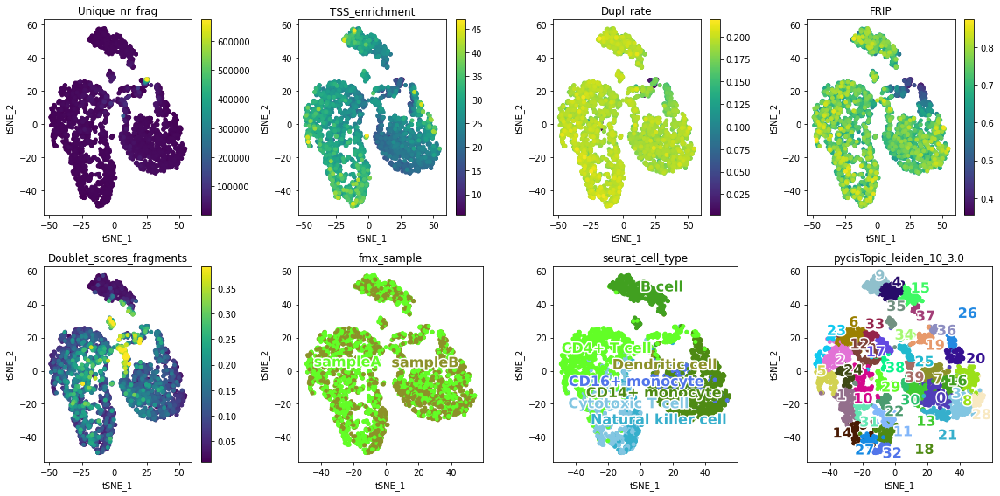

STA_10xv11_1.FIXEDCELLS
	cistopic_objects/STA_10xv11_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


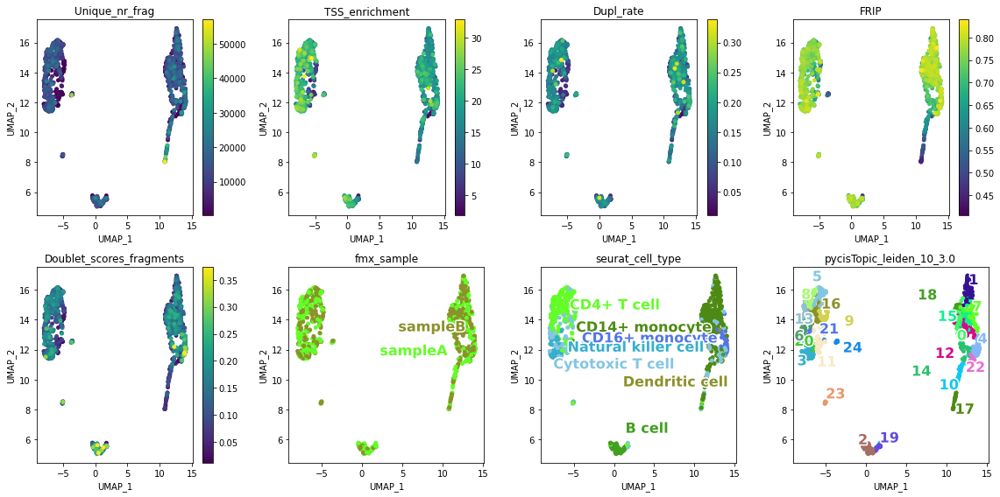

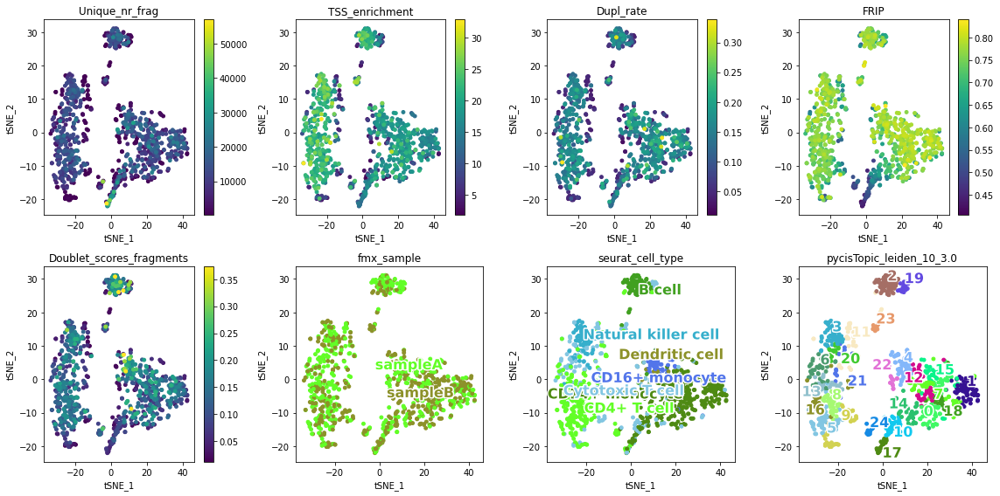

STA_10xv11_2.FIXEDCELLS
	cistopic_objects/STA_10xv11_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


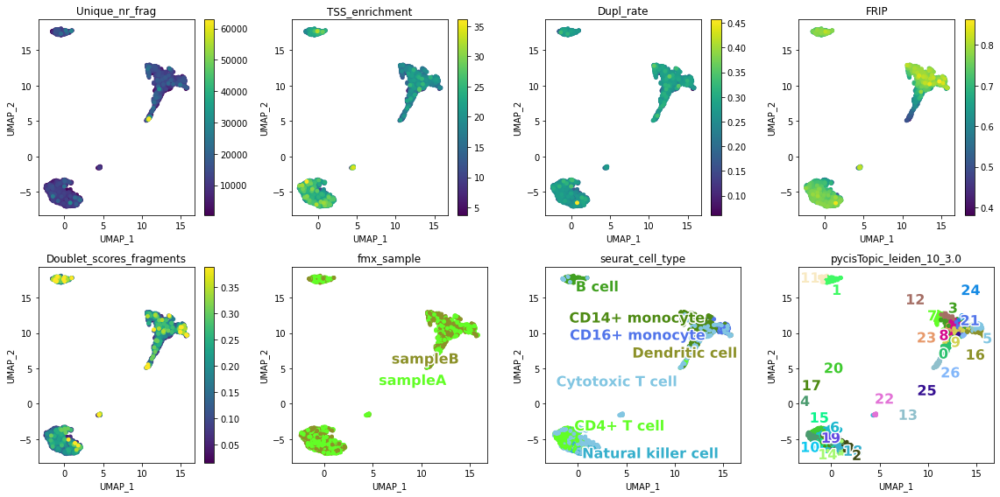

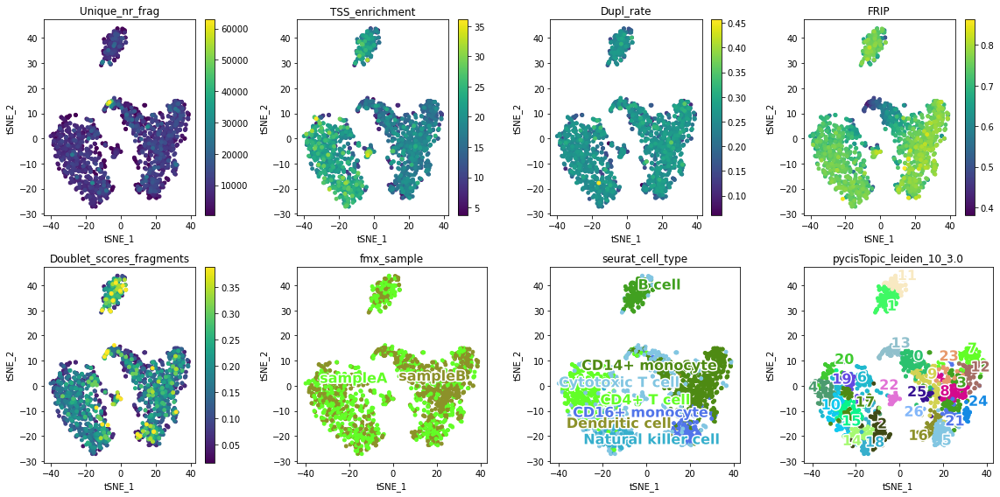

TXG_10xv11_1.FIXEDCELLS
2022-09-14 09:31:24,847 cisTopic     INFO     Finding neighbours
2022-09-14 09:31:25,572 cisTopic     INFO     Running UMAP
2022-09-14 09:31:52,511 cisTopic     INFO     Running FItSNE
Will use momentum during exaggeration phase
Computing input similarities...
Using perplexity, so normalizing input data (to prevent numerical problems)
Using perplexity, not the manually set kernel width.  K (number of nearest neighbors) and sigma (bandwidth) parameters are going to be ignored.
Using ANNOY for knn search, with parameters: n_trees 50 and search_k 4500
Going to allocate memory. N: 9501, K: 90, N*K = 855090
Building Annoy tree...
Done building tree. Beginning nearest neighbor search... 
parallel (128 threads):


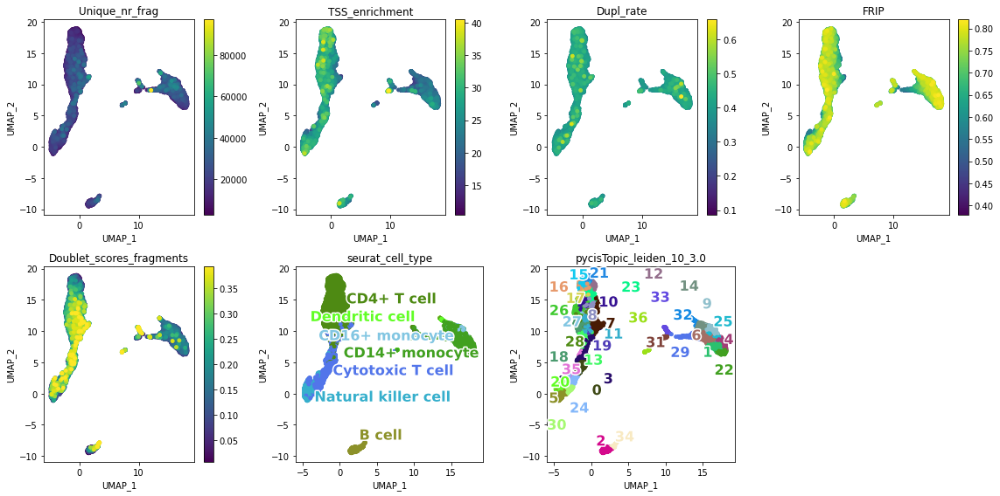

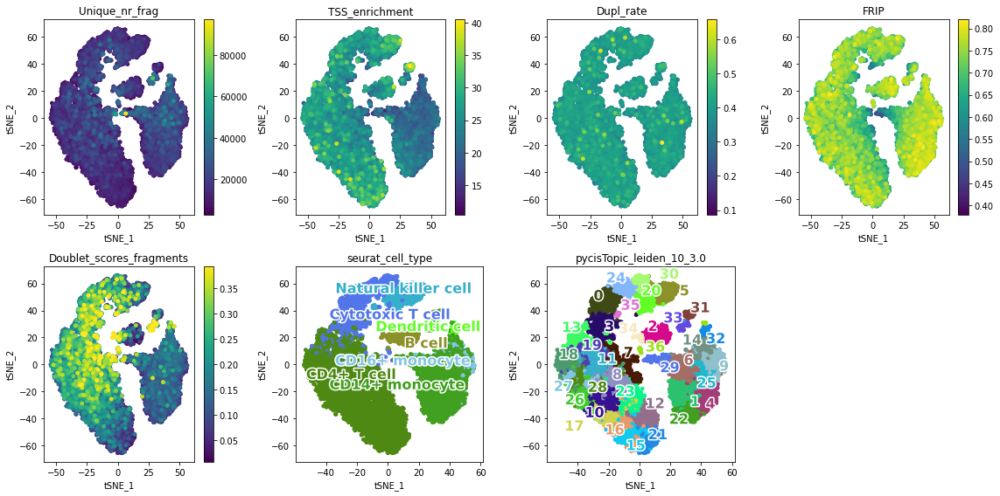

TXG_10xv2_1.FIXEDCELLS
2022-09-14 09:33:00,737 cisTopic     INFO     Finding neighbours
2022-09-14 09:33:01,286 cisTopic     INFO     Running UMAP
2022-09-14 09:33:14,071 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.013531)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.96 seconds), cost 4.482250
Iteration 100 (50 iterations in 0.96 seconds), cost 4.026448
Iteration 150 (50 iterations in 0.96 seconds), cost 3.934994
Iteration 200 (50 iterations in 0.96 seconds), cost 3.898433
Iteration 250 (50 iterations in 0.96 seconds), cost 3.878594
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.96 seconds), cost 2.668456
Iteration 350 (50 iterations in 0.96 seconds), cost 2.294241
Iteration 400 (50 iterations in 1.05 seconds), cost 2.111790
Iteration 450 (50 iterations in 1.29 seconds), cost 2.000989
Iteration 500 (50 iterations in 2

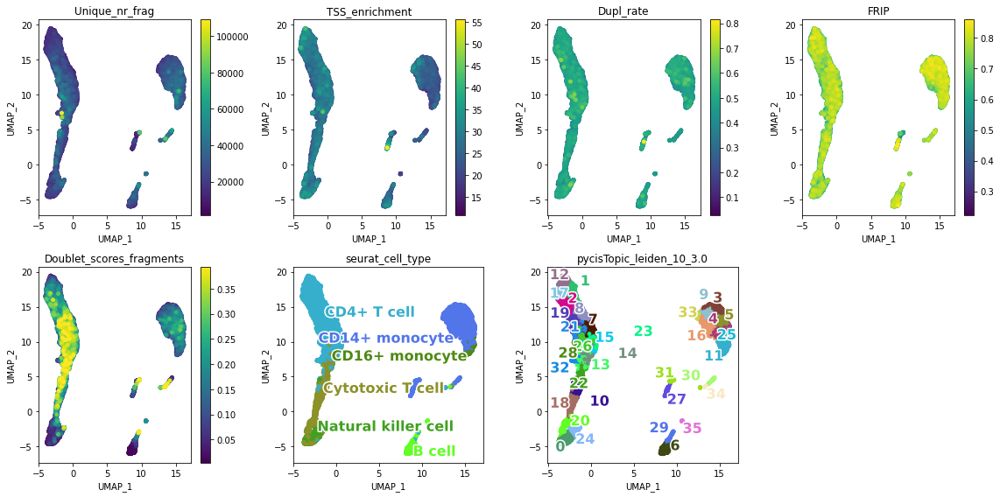

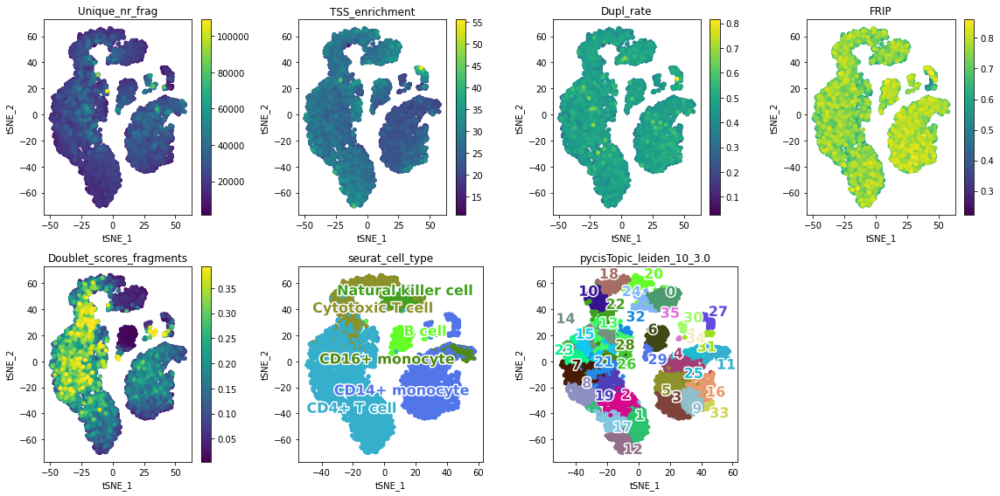

TXG_10xv2_2.FIXEDCELLS
2022-09-14 09:34:17,040 cisTopic     INFO     Finding neighbours
2022-09-14 09:34:18,912 cisTopic     INFO     Running UMAP
2022-09-14 09:34:32,078 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.013080)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.95 seconds), cost 4.450076
Iteration 100 (50 iterations in 0.96 seconds), cost 3.939393
Iteration 150 (50 iterations in 0.96 seconds), cost 3.809959
Iteration 200 (50 iterations in 0.96 seconds), cost 3.753866
Iteration 250 (50 iterations in 0.95 seconds), cost 3.722284
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.96 seconds), cost 2.591552
Iteration 350 (50 iterations in 0.96 seconds), cost 2.173196
Iteration 400 (50 iterations in 1.08 seconds), cost 1.966612
Iteration 450 (50 iterations in 1.33 seconds), cost 1.843698
Iteration 500 (50 iterations in 2

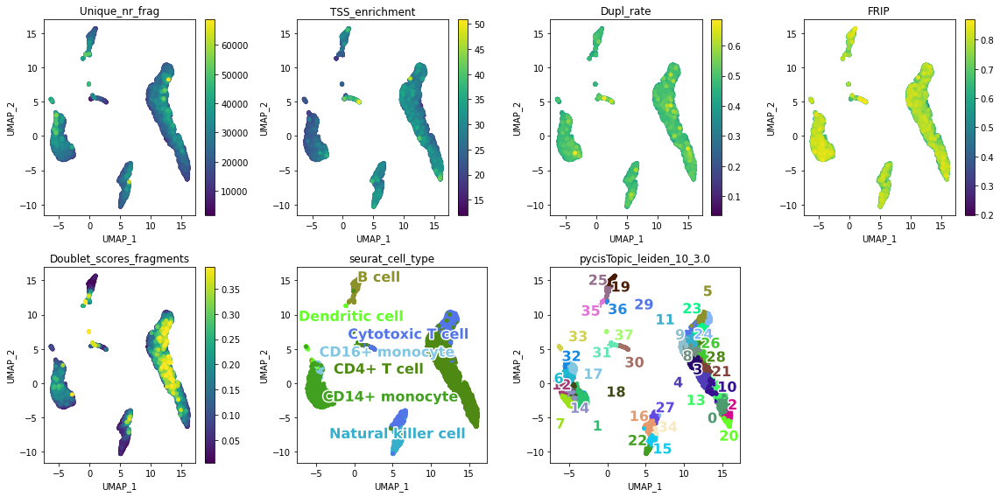

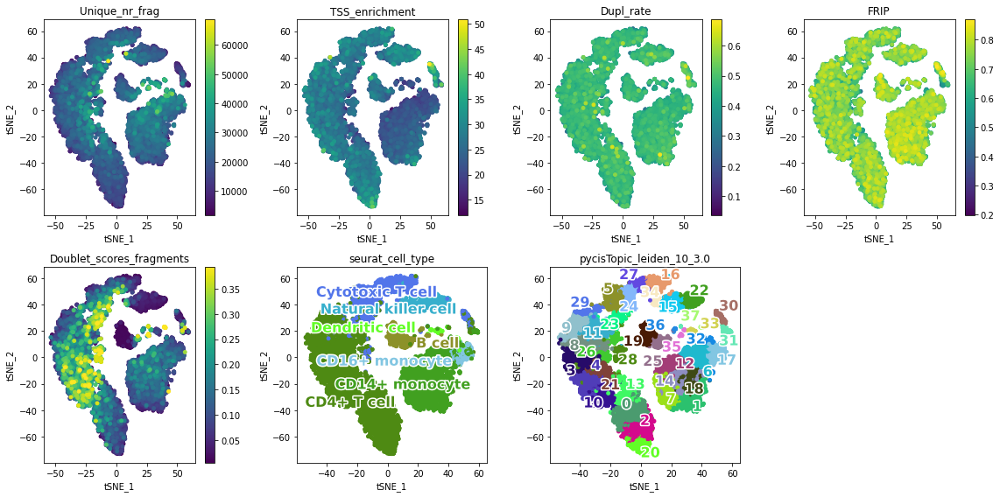

UCS_ddseq_1.FIXEDCELLS
2022-09-14 09:35:40,742 cisTopic     INFO     Finding neighbours
2022-09-14 09:35:40,977 cisTopic     INFO     Running UMAP
2022-09-14 09:35:47,748 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.013166)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.95 seconds), cost 4.412713
Iteration 100 (50 iterations in 0.96 seconds), cost 3.872712
Iteration 150 (50 iterations in 0.96 seconds), cost 3.735070
Iteration 200 (50 iterations in 0.96 seconds), cost 3.674394
Iteration 250 (50 iterations in 0.96 seconds), cost 3.641321
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.96 seconds), cost 2.556487
Iteration 350 (50 iterations in 0.96 seconds), cost 2.151224
Iteration 400 (50 iterations in 1.12 seconds), cost 1.952888
Iteration 450 (50 iterations in 1.37 seconds), cost 1.835483
Iteration 500 (50 iterations in 2

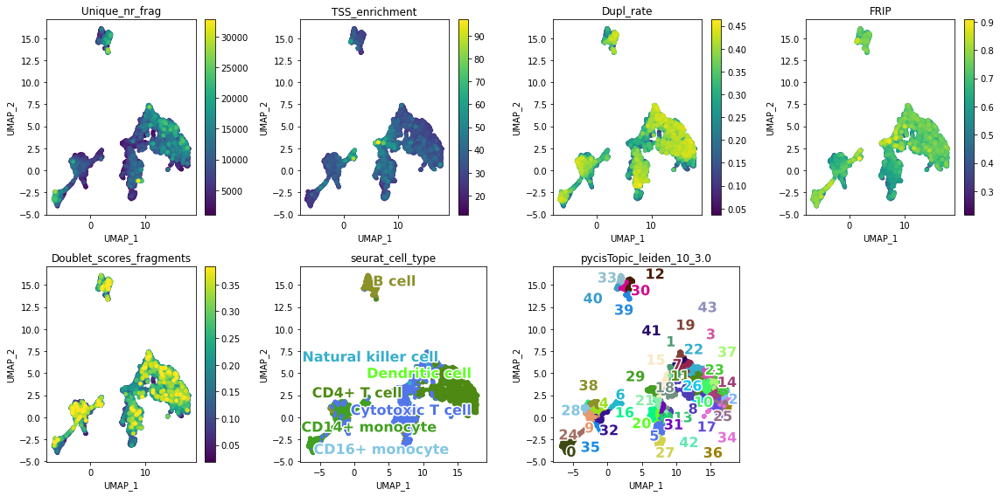

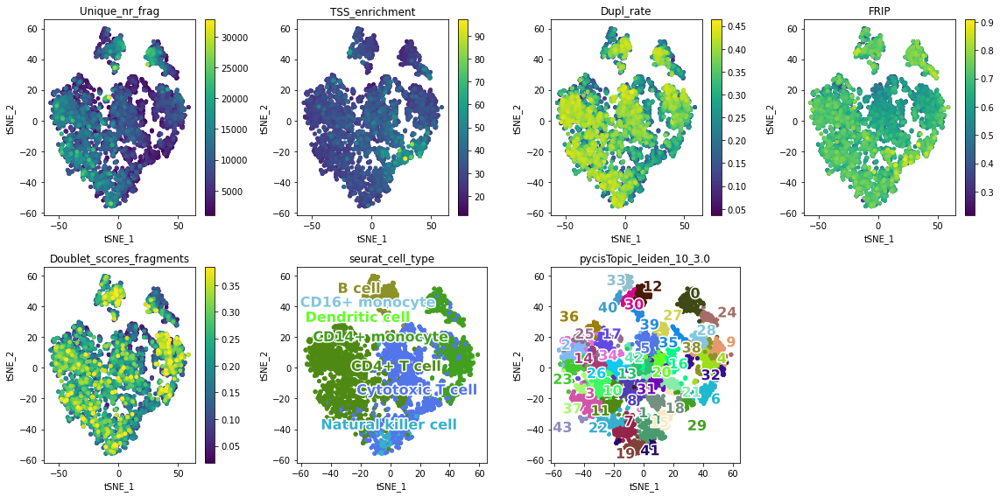

UCS_ddseq_2.FIXEDCELLS
2022-09-14 09:36:36,492 cisTopic     INFO     Finding neighbours
2022-09-14 09:36:36,689 cisTopic     INFO     Running UMAP
2022-09-14 09:36:42,751 cisTopic     INFO     Running FItSNE

Symmetrizing...
Using the given initialization.
Exaggerating Ps by 12.000000
Input similarities computed (sparsity = 0.024151)!
Learning embedding...
Using FIt-SNE approximation.
Iteration 50 (50 iterations in 0.78 seconds), cost 3.919725
Iteration 100 (50 iterations in 0.79 seconds), cost 3.561761
Iteration 150 (50 iterations in 0.79 seconds), cost 3.500192
Iteration 200 (50 iterations in 0.79 seconds), cost 3.475805
Iteration 250 (50 iterations in 0.79 seconds), cost 3.462353
Unexaggerating Ps by 12.000000
Iteration 300 (50 iterations in 0.79 seconds), cost 2.073033
Iteration 350 (50 iterations in 0.79 seconds), cost 1.671770
Iteration 400 (50 iterations in 0.85 seconds), cost 1.488145
Iteration 450 (50 iterations in 1.08 seconds), cost 1.382677
Iteration 500 (50 iterations in 1

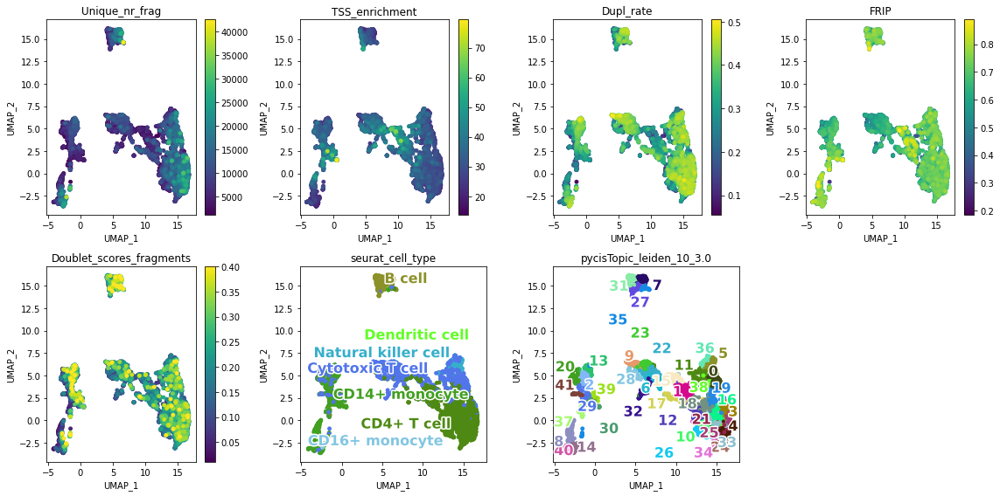

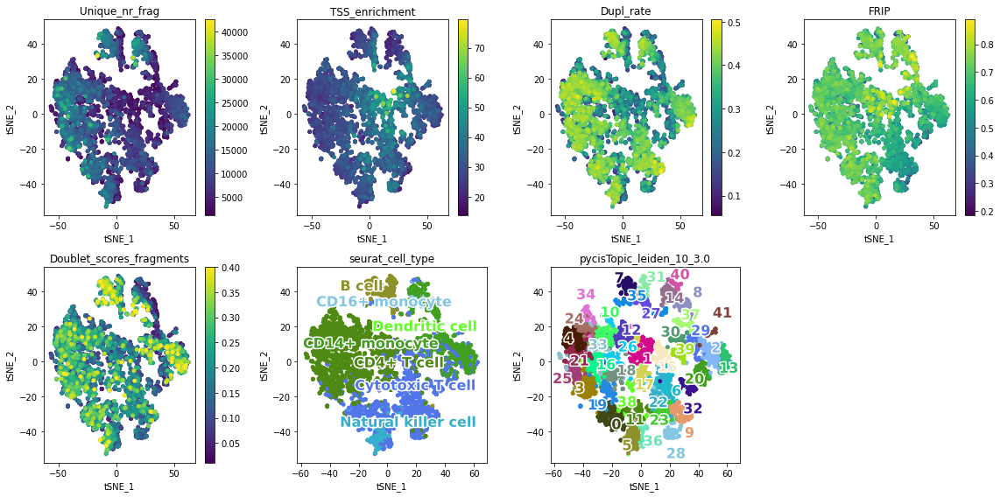

VIB_10xmultiome_1.FIXEDCELLS
	cistopic_objects/VIB_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


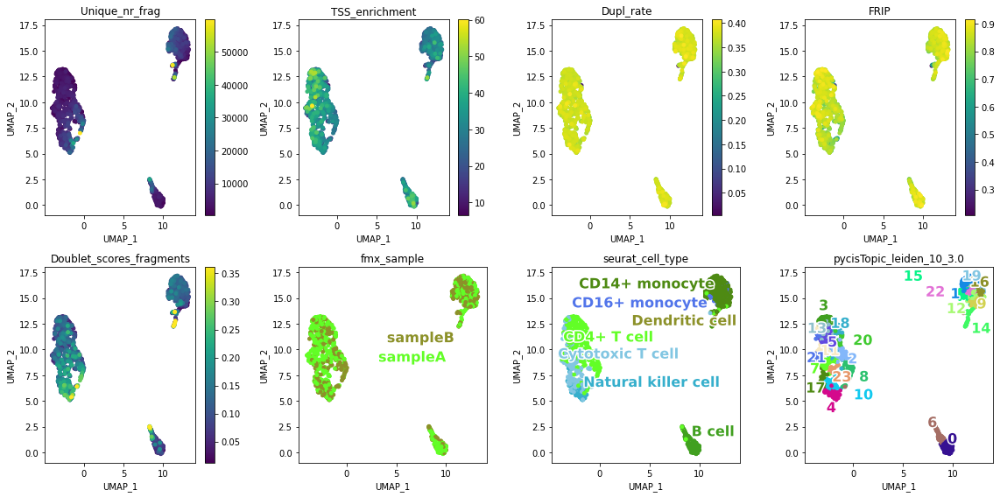

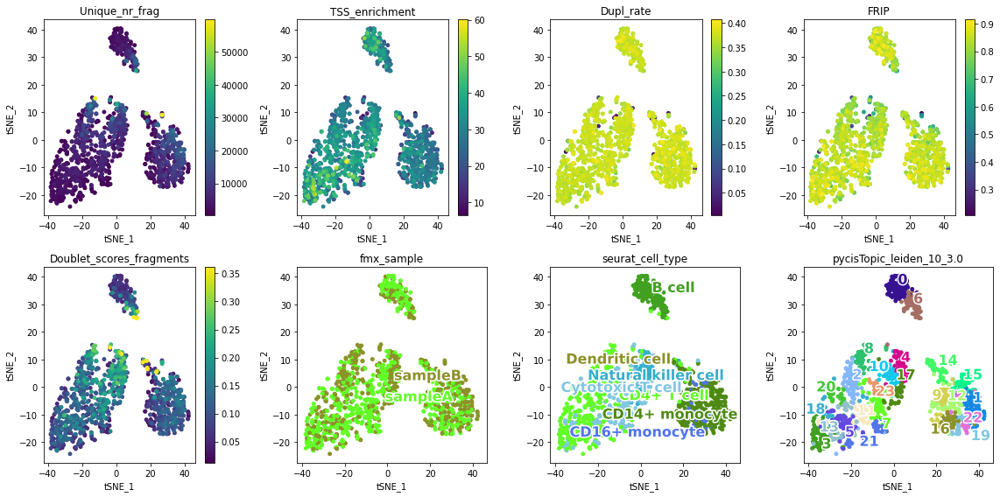

VIB_10xmultiome_2.FIXEDCELLS
	cistopic_objects/VIB_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl exists, skipping


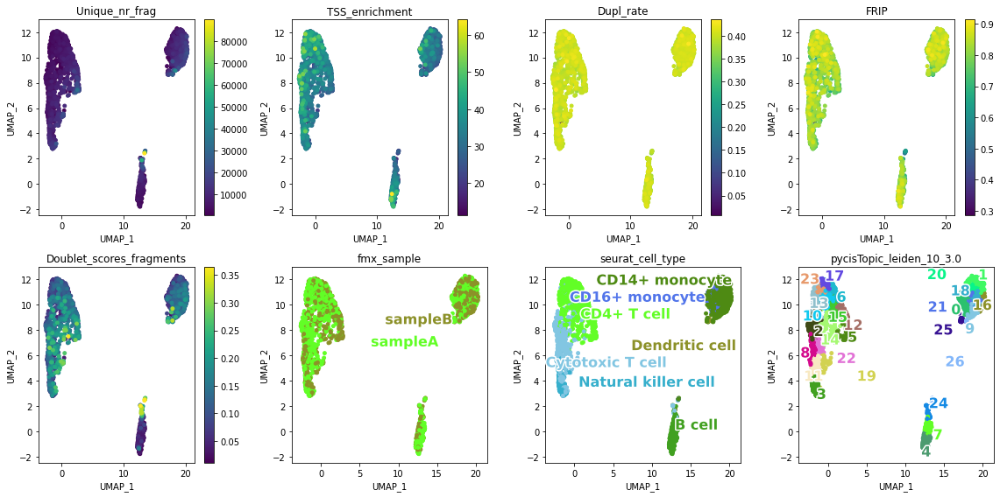

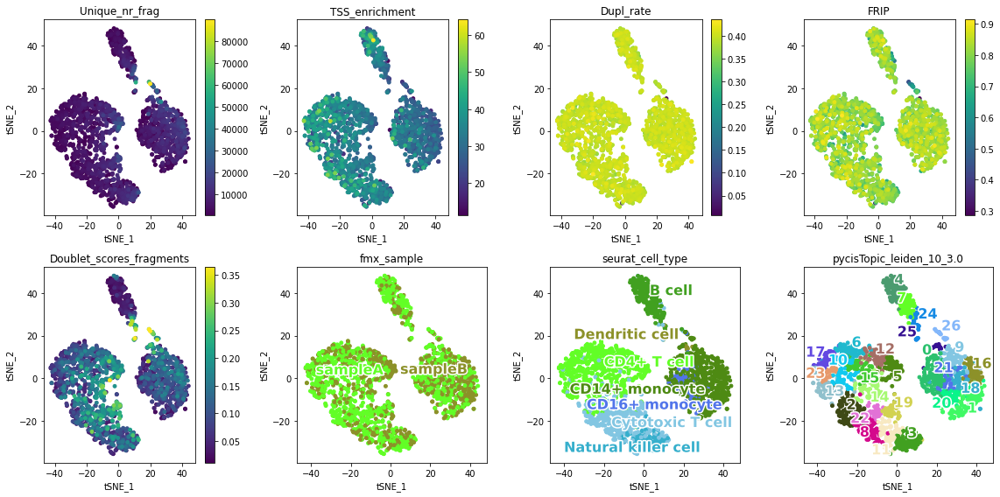

VIB_10xv1_1.FIXEDCELLS
	cistopic_objects/VIB_10xv1_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.pkl exists, skipping


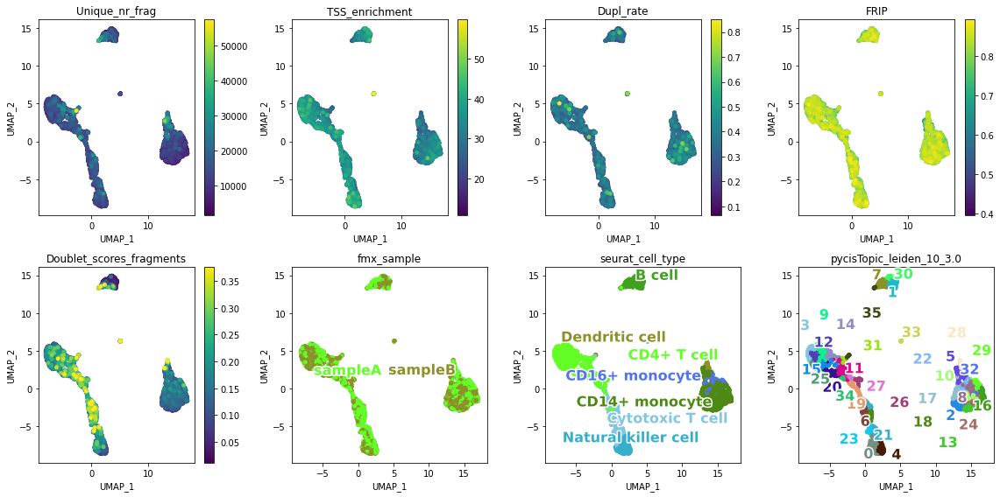

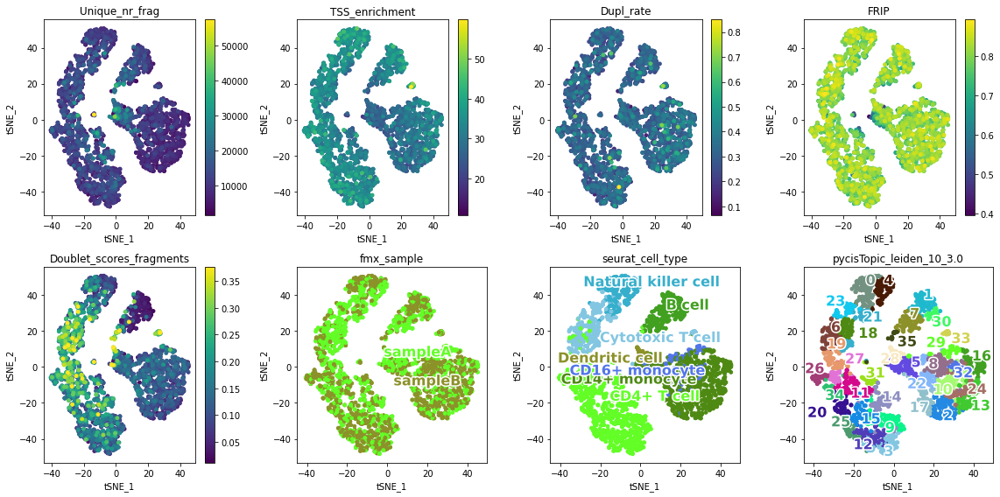

VIB_10xv1_2.FIXEDCELLS
	cistopic_objects/VIB_10xv1_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl exists, skipping


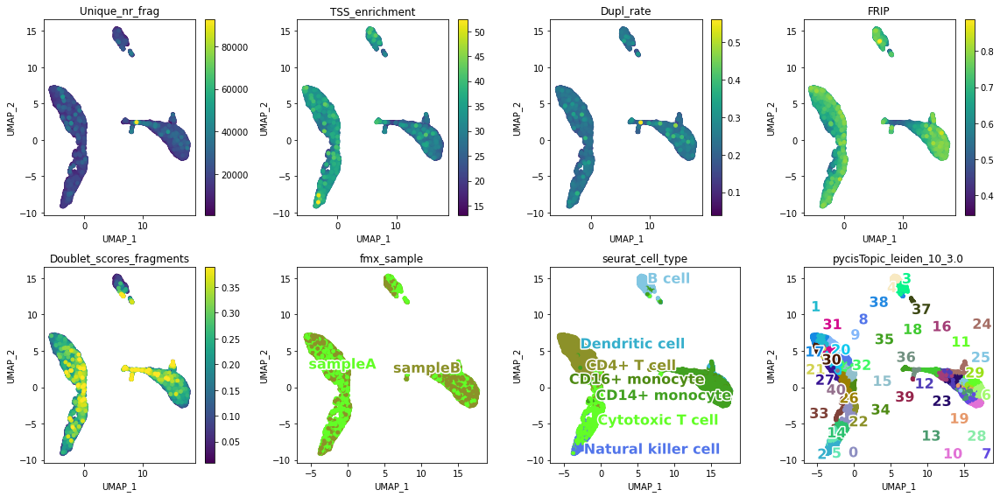

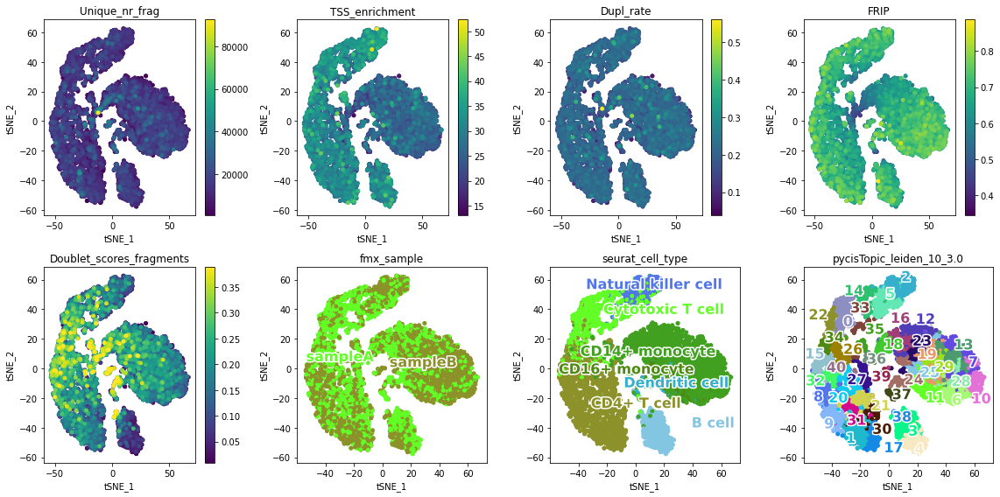

VIB_10xv2_1.FIXEDCELLS
	cistopic_objects/VIB_10xv2_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl exists, skipping


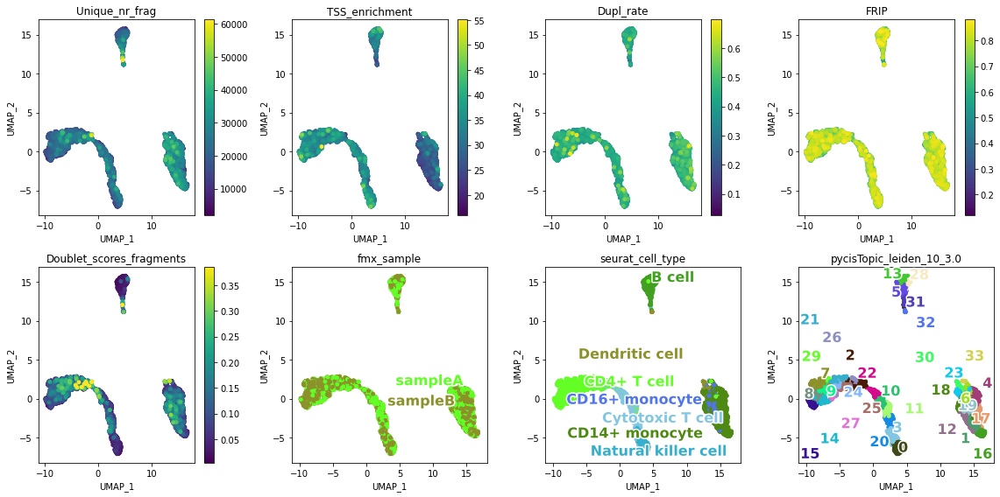

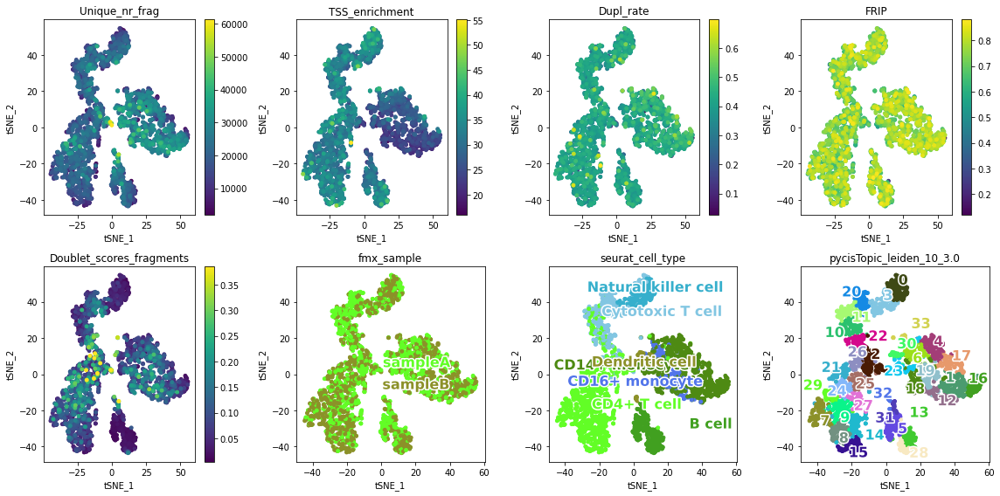

VIB_10xv2_2.FIXEDCELLS
	cistopic_objects/VIB_10xv2_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


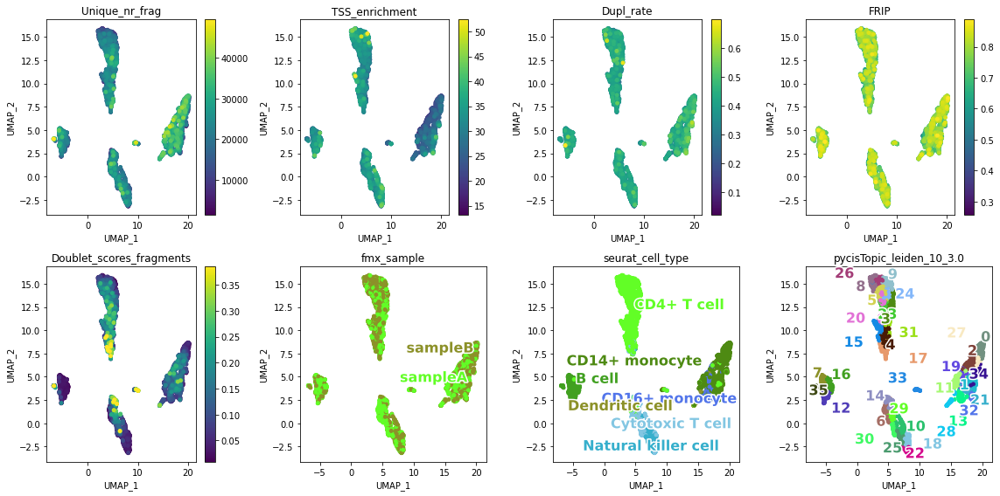

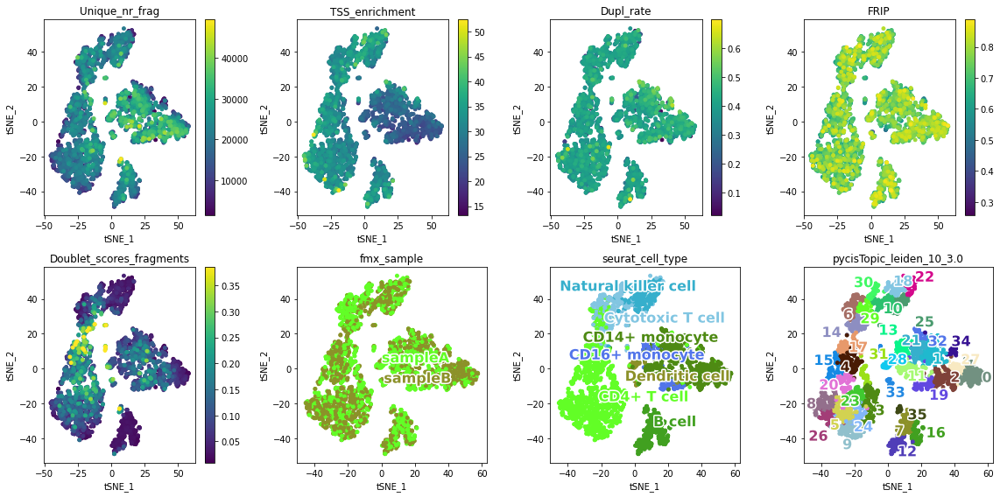

VIB_hydrop_1.FIXEDCELLS
	cistopic_objects/VIB_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl exists, skipping


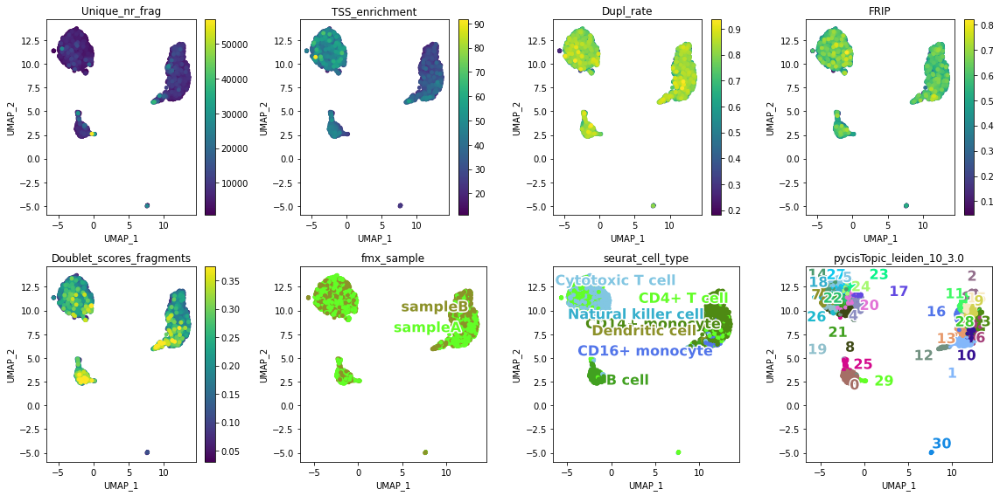

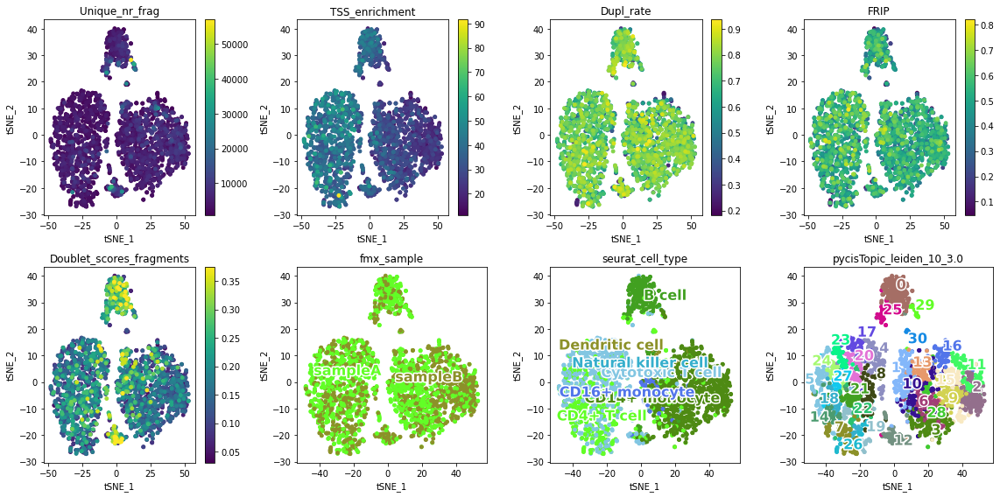

VIB_hydrop_11.FIXEDCELLS
	Predictions do not exist for VIB_hydrop_11.FIXEDCELLS! Skipping
VIB_hydrop_12.FIXEDCELLS
	Predictions do not exist for VIB_hydrop_12.FIXEDCELLS! Skipping
VIB_hydrop_2.FIXEDCELLS
	cistopic_objects/VIB_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.pkl exists, skipping


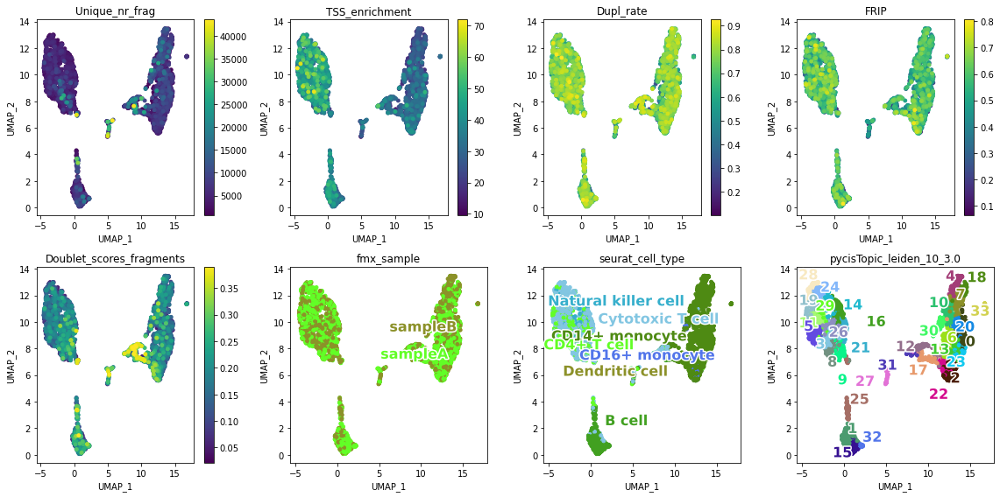

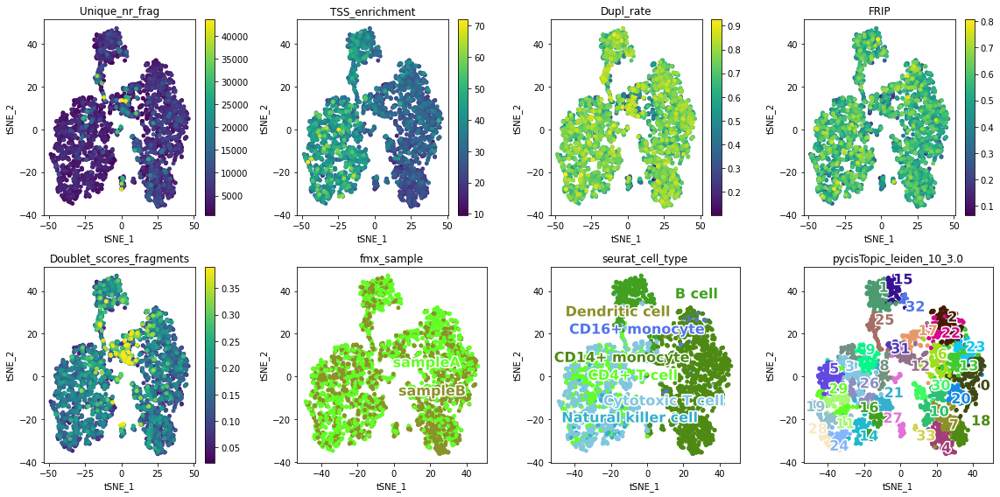

VIB_hydrop_21.FIXEDCELLS
	Predictions do not exist for VIB_hydrop_21.FIXEDCELLS! Skipping
VIB_hydrop_22.FIXEDCELLS
	Predictions do not exist for VIB_hydrop_22.FIXEDCELLS! Skipping


In [6]:
leiden_res = [3.0]
to_plot_leiden = ["pycisTopic_leiden_10_" + str(x) for x in leiden_res]

to_plot_vars = ['Unique_nr_frag', 'TSS_enrichment', 'Dupl_rate', 'FRIP', 'Doublet_scores_fragments', 'fmx_sample', 'seurat_cell_type']

for sample in cto_model_path_dict.keys():
#for sample in ['VIB_10xv1_1.FULL']:
    to_plot = to_plot_vars + to_plot_leiden
    
    print(sample)
    cto_path = cto_model_path_dict[sample]
    cto_path_new = cto_path.replace('.pkl', '.dimreduc.pkl')
    
    if not sample in prediction_path_dict.keys():
        print(f'\tPredictions do not exist for {sample}! Skipping')
        
    else:
        predictions_path = prediction_path_dict[sample]

        if not os.path.exists(cto_path_new):
            with open(cto_path, 'rb') as f:
                cto = pickle.load(f)
                
            ct_pred = pd.read_csv(predictions_path,sep='\t')

            # format to add to cistopic object:
            ct_annot = ct_pred[['composite_sample_id','cell_type','cell_type_pred_score']].copy().set_index('composite_sample_id')
            ct_annot.columns = ['seurat_cell_type','seurat_cell_type_pred_score']
            ct_annot.index = [x.replace('-', '___') for x in ct_annot.index]
            if sample.split('.')[0] in ['VIB_hydrop_1', 'VIB_hydrop_2']:
                ct_annot.index = [x.split('___')[0] + '___' + x.split('___')[2].split('.')[0] + x.split('___')[1] + '.' + x.split('___')[2].split('.')[-1] for x in ct_annot.index]
                
            cto.add_cell_data(ct_annot)

            cto.projections['cell'] = {}
            find_clusters(cto,
                      target  = 'cell',
                      k = 10,
                      res = leiden_res,
                      prefix = 'pycisTopic_')
            run_umap(cto, target = 'cell')
            run_tsne(cto, target = 'cell')
            
            if not "fmx_sample" in cto.cell_data.columns:
                to_plot.remove('fmx_sample')
                
            n_to_plot = len(to_plot)
            n_cols = 4
            n_rows = math.ceil(n_to_plot/n_cols)
            
            plot_metadata(cto,
            reduction_name='UMAP',
            variables=to_plot,
            target='cell',
            num_columns=4,
            text_size=16,
            dot_size=15,
            figsize=(n_cols*4,n_rows*4),
            save=f"plots_qc/{sample}__umap_summary.png"
            )

            plot_metadata(cto,
            reduction_name='tSNE',
            variables=to_plot,
            target='cell',
            num_columns=4,
            text_size=16,
            dot_size=15,
            figsize=(n_cols*4,n_rows*4),
            save=f"plots_qc/{sample}__tsne_summary.png"
            )
            
            with open(cto_path_new, "wb") as f:
                pickle.dump(cto, f, protocol=4)
                
        else:
            print(f"\t{cto_path_new} exists, skipping")
            
            umap_path = f"plots_qc/{sample}__umap_summary.png"
            tsne_path = f"plots_qc/{sample}__tsne_summary.png"
            
            if os.path.exists(umap_path):
                display(Image(umap_path))
                
            else:
                with open(cto_path_new, 'rb') as f:
                    cto = pickle.load(f)

                if not "fmx_sample" in cto.cell_data.columns:
                    to_plot.remove('fmx_sample')

                n_to_plot = len(to_plot)
                n_cols = 4
                n_rows = math.ceil(n_to_plot/n_cols)

                plot_metadata(cto,
                reduction_name='UMAP',
                variables=to_plot,
                target='cell',
                num_columns=4,
                text_size=16,
                dot_size=15,
                figsize=(n_cols*4,n_rows*4),
                save=f"plots_qc/{sample}__umap_summary.png"
                )
                
            if os.path.exists(tsne_path):
                display(Image(tsne_path))
                
            else:
                with open(cto_path_new, 'rb') as f:
                    cto = pickle.load(f)
                    
                n_to_plot = len(to_plot)
                n_cols = 4
                n_rows = math.ceil(n_to_plot/n_cols)
                
                plot_metadata(cto,
                reduction_name='tSNE',
                variables=to_plot,
                target='cell',
                num_columns=4,
                text_size=16,
                dot_size=15,
                figsize=(n_cols*4,n_rows*4),
                save=f"plots_qc/{sample}__tsne_summary.png"
                )

# derive consensus clusters

In [7]:
cto_model_path_dict = {x.split('/')[-1].split(f'__')[0]: x for x in sorted(glob.glob("cistopic_objects/*singlets.model*dimreduc.pkl"))}
cto_model_path_dict

{'BIO_ddseq_1.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.pkl',
 'BIO_ddseq_2.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.pkl',
 'BIO_ddseq_3.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.pkl',
 'BIO_ddseq_4.FIXEDCELLS': 'cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.pkl',
 'BRO_mtscatac_1.FIXEDCELLS': 'cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl',
 'BRO_mtscatac_2.FIXEDCELLS': 'cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.pkl',
 'CNA_10xmultiome_1.FIXEDCELLS': 'cistopic_objects/CNA_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.pkl',
 'CNA_10xmultiome_2.FIXEDCELLS': 'cistopic_objects/CNA_10xmultiome_2.FIXEDCELLS__c

cell_types = list(celldata['seurat_cell_type'].unique())
palette = list(sns.color_palette('husl',len(cell_types)))
palette = list(sns.color_palette('Set2'))

color_palette = {cell_type: palette[cell_types.index(cell_type)] for cell_type in cell_types}

pprint.pprint(color_palette)

In [8]:
color_palette = {
    'B cell': (0.5105309046900421, 0.6614299289084904, 0.1930849118538962),
    'CD14+ monocyte': (0.7757319041862729, 0.5784925270759935, 0.19475566538551875),
    'CD16+ monocyte': (0.21662978923073606, 0.6676586160122123, 0.7318695594345369),
    'CD4+ T cell': (0.20433460114757862, 0.6863857739476534, 0.5407103379425205),
    'Cytotoxic T cell': (0.9587050080494409, 0.3662259565791742, 0.9231469575614251),
    'Dendritic cell': (0.5049017849530067, 0.5909119231215284, 0.9584657252128558),
    'Natural killer cell': (0.9677975592919913, 0.44127456009157356, 0.5358103155058701)
}

In [9]:
palette_dict = {x: color_palette for x in ['seurat_cell_type', "consensus_cell_type"]}

cistopic_objects/BIO_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


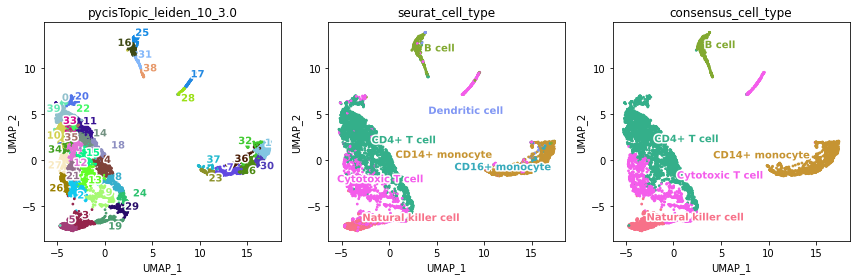

cistopic_objects/BIO_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.consensus.pkl already exists!


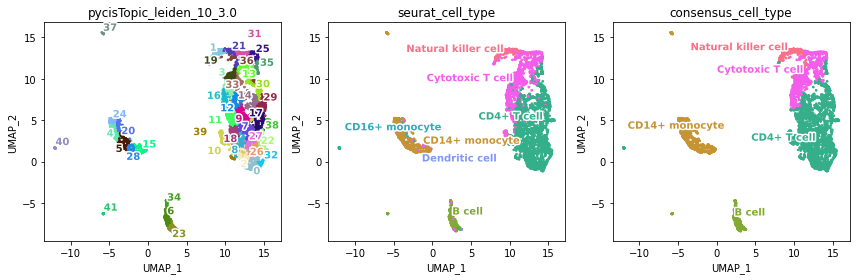

cistopic_objects/BIO_ddseq_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


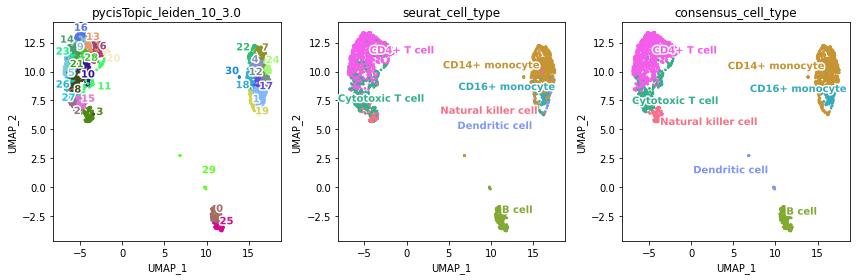

cistopic_objects/BIO_ddseq_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.consensus.pkl already exists!


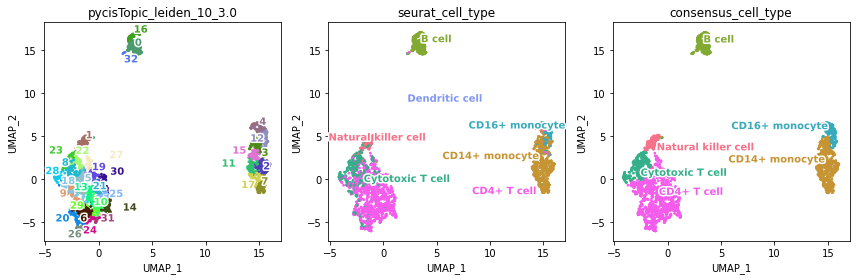

cistopic_objects/BRO_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


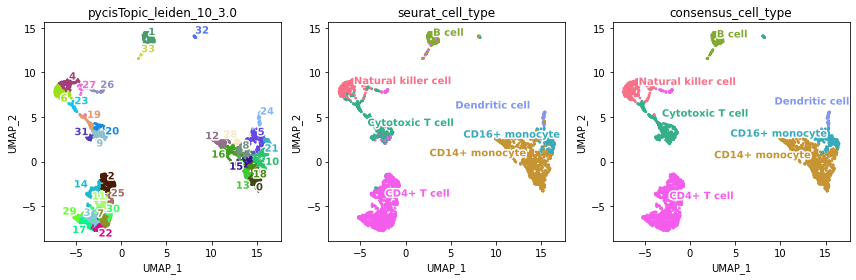

cistopic_objects/BRO_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


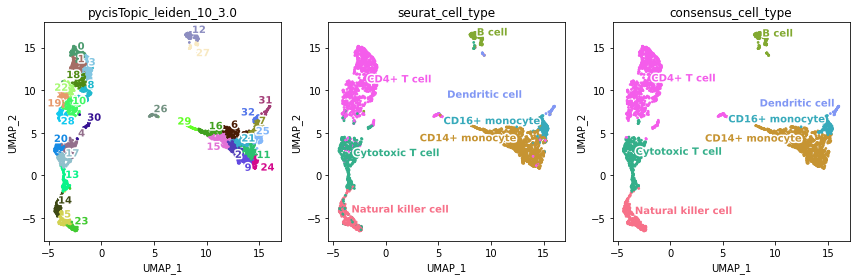

cistopic_objects/CNA_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


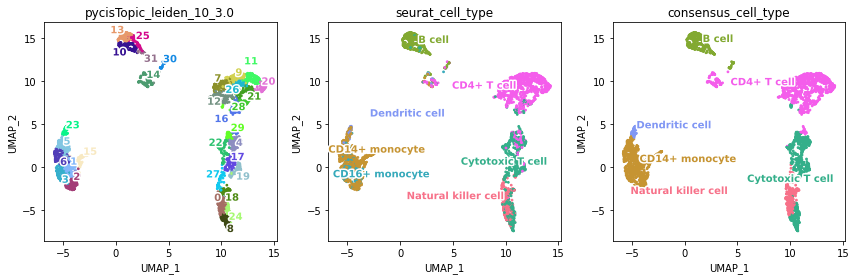

cistopic_objects/CNA_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


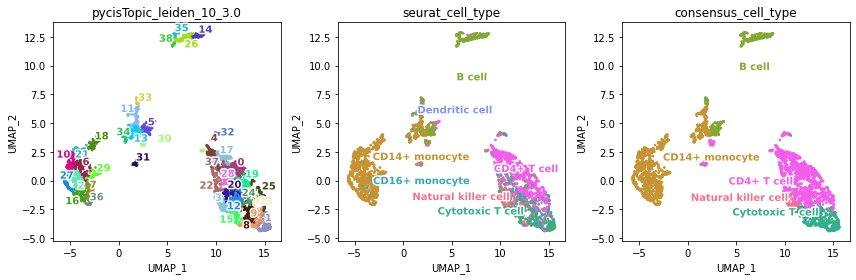

cistopic_objects/CNA_10xv11_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


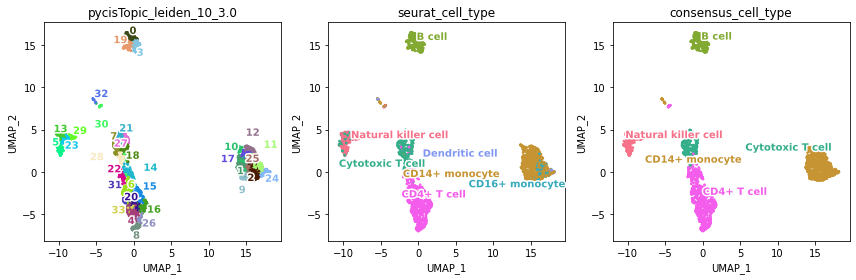

cistopic_objects/CNA_10xv11_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.consensus.pkl already exists!


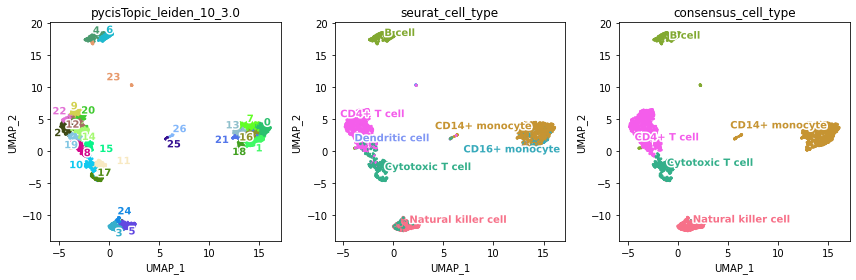

cistopic_objects/CNA_10xv11_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


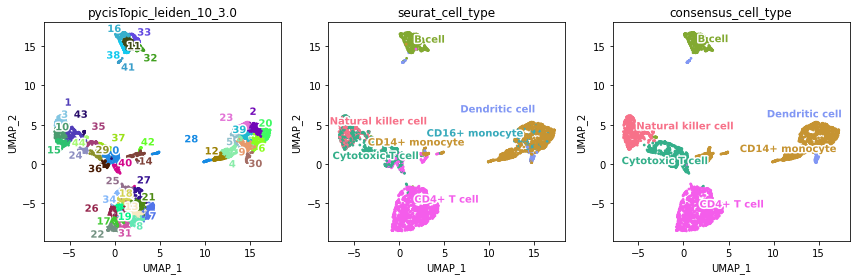

cistopic_objects/CNA_10xv11_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


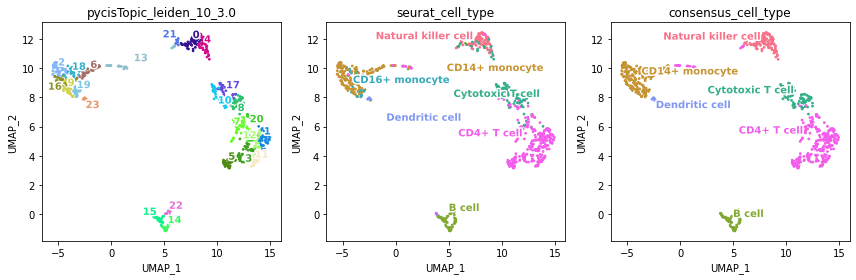

cistopic_objects/CNA_10xv11_5.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


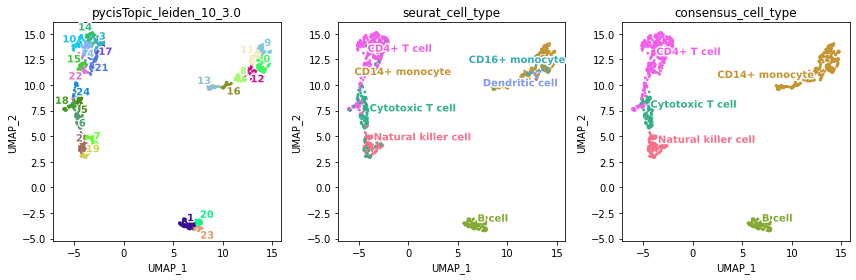

cistopic_objects/CNA_10xv2_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


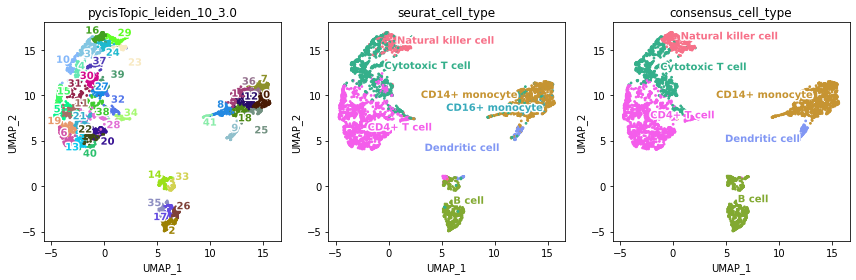

cistopic_objects/CNA_10xv2_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


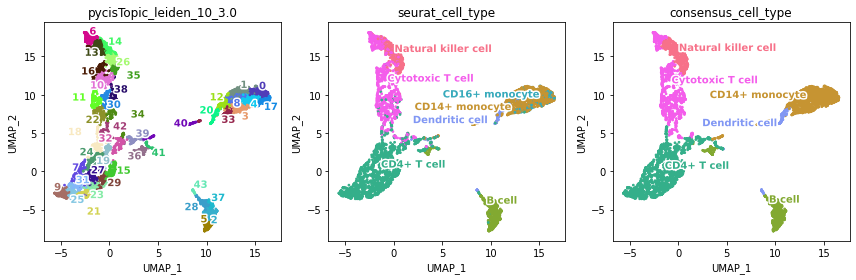

cistopic_objects/CNA_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


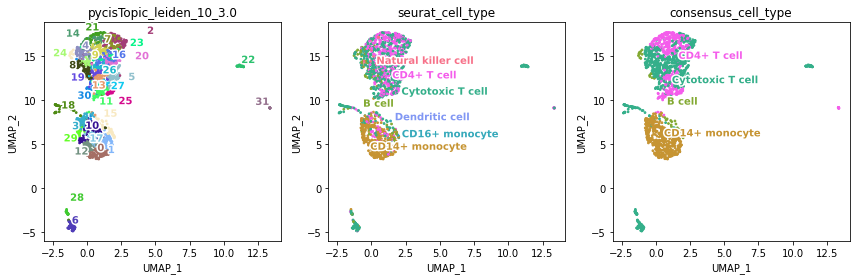

cistopic_objects/CNA_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


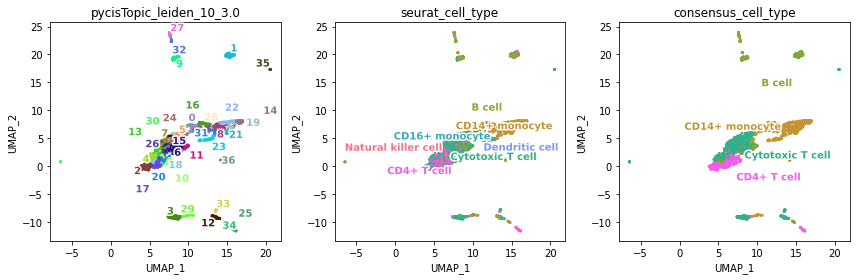

cistopic_objects/CNA_hydrop_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.consensus.pkl already exists!


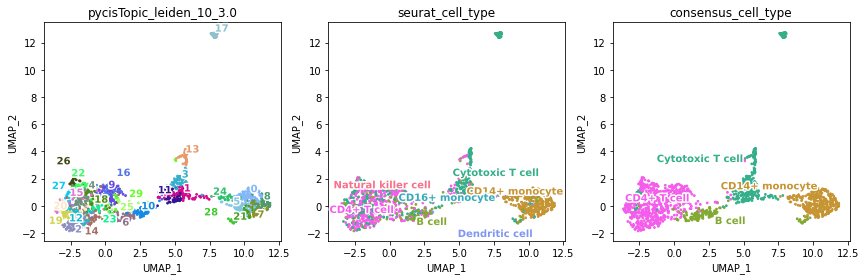

cistopic_objects/CNA_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


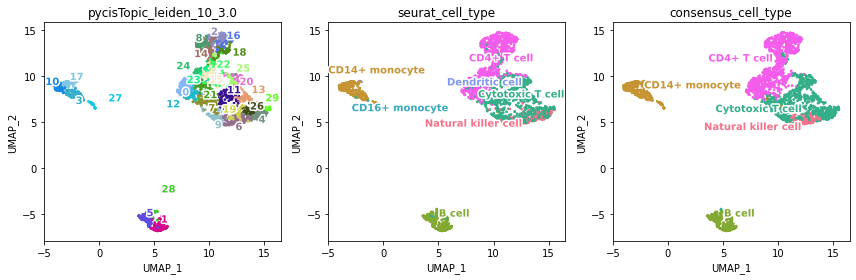

cistopic_objects/CNA_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_14topics.dimreduc.consensus.pkl already exists!


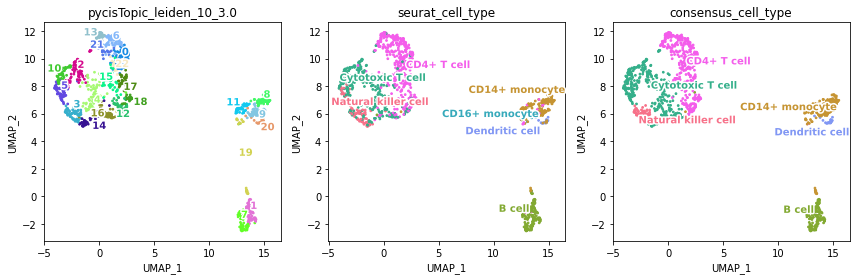

cistopic_objects/EPF_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


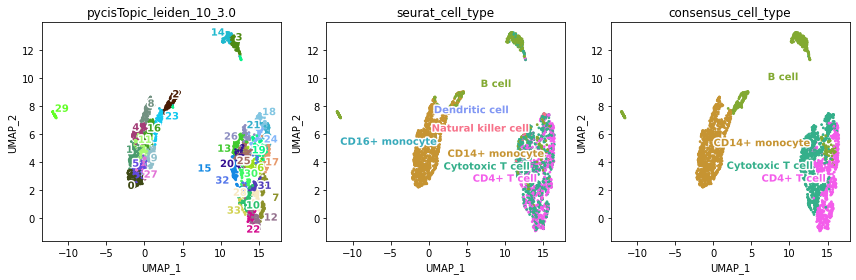

cistopic_objects/EPF_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.consensus.pkl already exists!


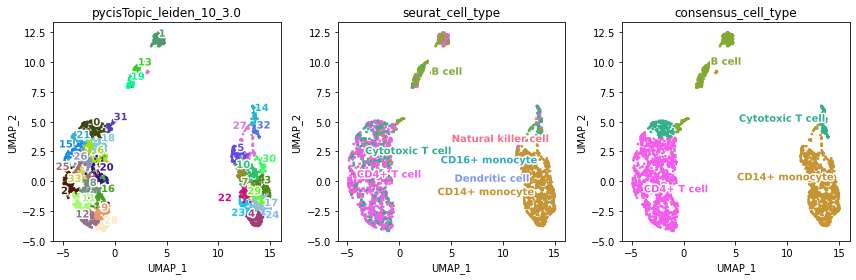

cistopic_objects/EPF_hydrop_3.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


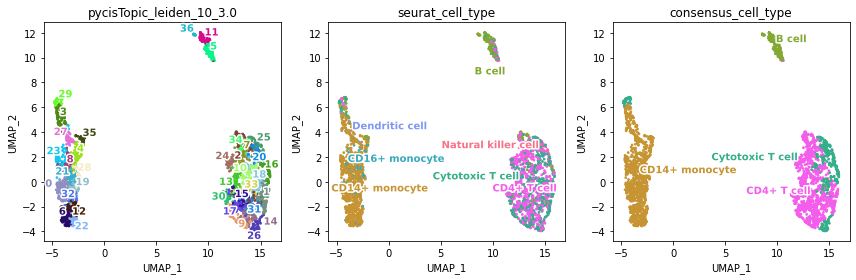

cistopic_objects/EPF_hydrop_4.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_15topics.dimreduc.consensus.pkl already exists!


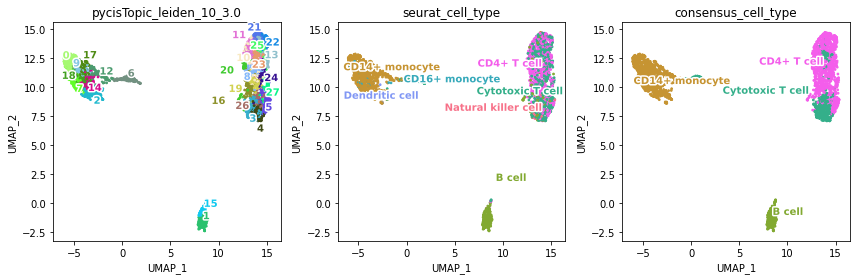

cistopic_objects/HAR_ddseq_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_17topics.dimreduc.consensus.pkl already exists!


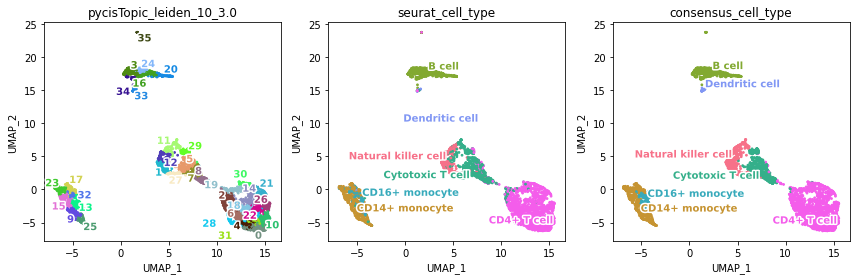

cistopic_objects/HAR_ddseq_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


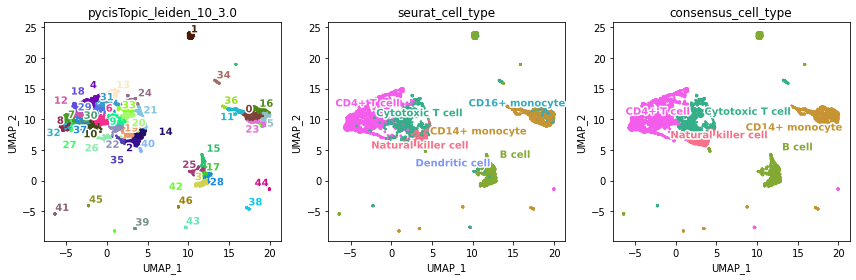

cistopic_objects/MDC_mtscatac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


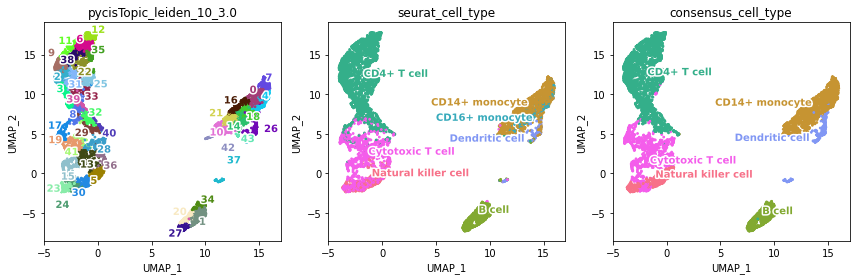

cistopic_objects/MDC_mtscatac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


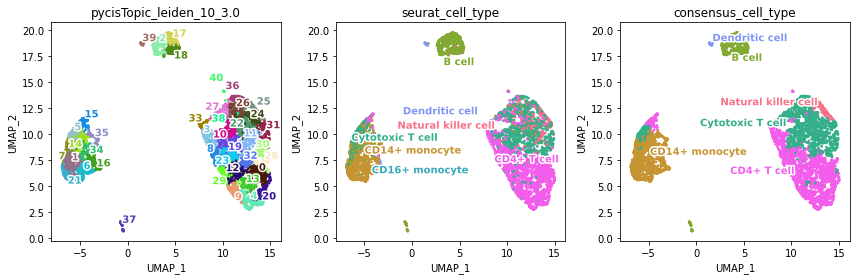

cistopic_objects/OHS_s3atac_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


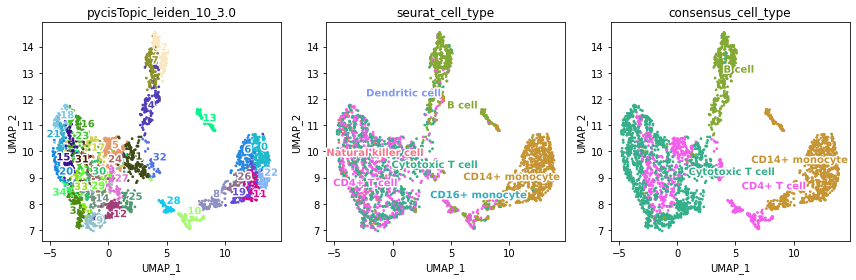

cistopic_objects/OHS_s3atac_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


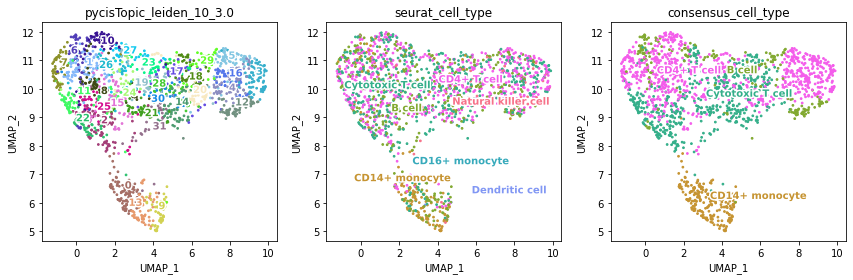

cistopic_objects/SAN_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


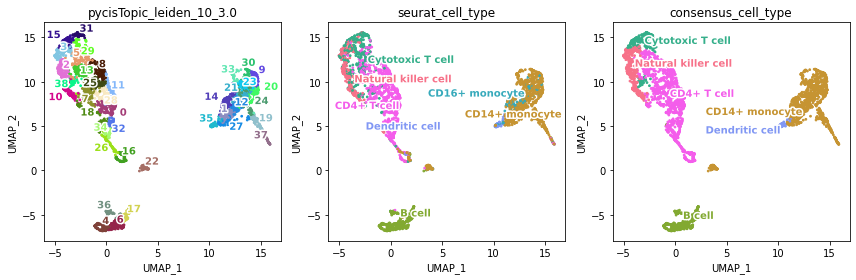

cistopic_objects/SAN_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


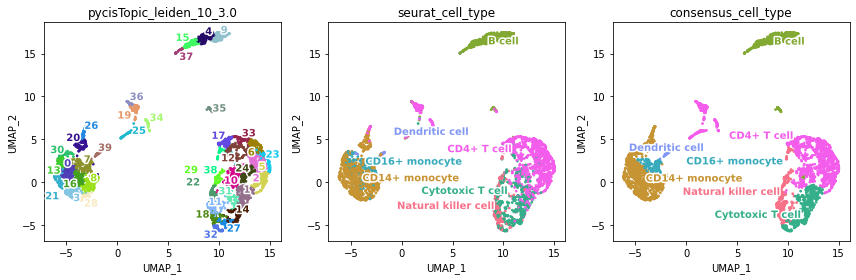

cistopic_objects/STA_10xv11_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


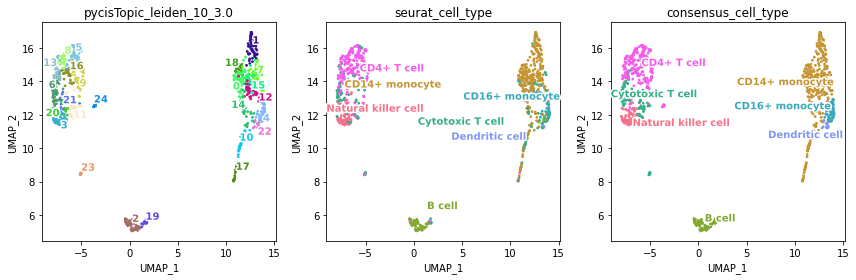

cistopic_objects/STA_10xv11_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


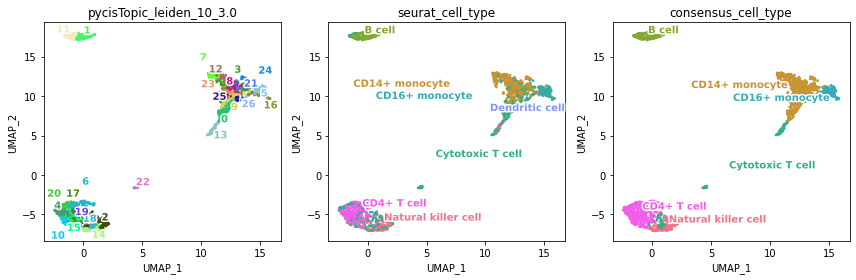

TXG_10xv11_1.FIXEDCELLS


,cluster,major_cell_type,frac_of_cluster,next_celltype,next_frac_of_cluster,diff_to_next,cluster_counts
TXG_10xv11_1.FIXEDCELLS__9,9,CD14+ monocyte,0.578947,CD16+ monocyte,0.421053,0.157895,323
TXG_10xv11_1.FIXEDCELLS__35,35,Natural killer cell,0.534483,Cytotoxic T cell,0.465517,0.068966,58
TXG_10xv11_1.FIXEDCELLS__36,36,B cell,0.372549,Dendritic cell,0.254902,0.117647,51
TXG_10xv11_1.FIXEDCELLS__33,33,CD14+ monocyte,0.4,CD4+ T cell,0.2625,0.1375,80
TXG_10xv11_1.FIXEDCELLS__13,13,CD4+ T cell,0.586441,Cytotoxic T cell,0.410169,0.176271,295


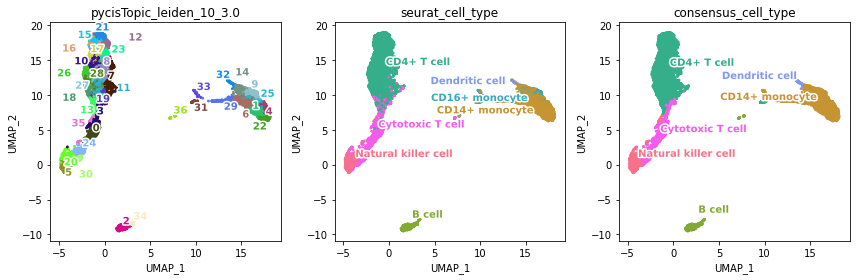

dumped_cto
TXG_10xv2_1.FIXEDCELLS
No discrepant clusters


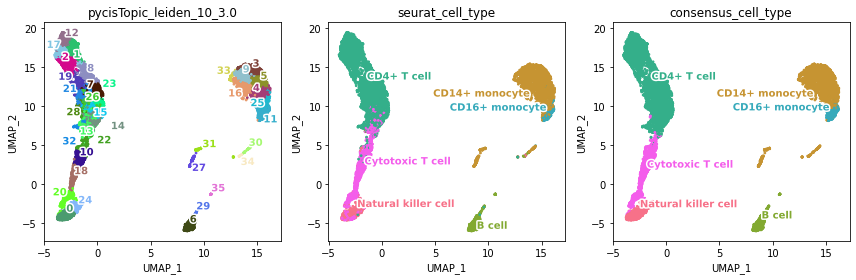

dumped_cto
TXG_10xv2_2.FIXEDCELLS


,cluster,major_cell_type,frac_of_cluster,next_celltype,next_frac_of_cluster,diff_to_next,cluster_counts
TXG_10xv2_2.FIXEDCELLS__32,32,CD14+ monocyte,0.467532,Dendritic cell,0.428571,0.038961,77
TXG_10xv2_2.FIXEDCELLS__35,35,Dendritic cell,0.529412,B cell,0.441176,0.088235,34
TXG_10xv2_2.FIXEDCELLS__37,37,CD14+ monocyte,0.45,CD4+ T cell,0.4,0.05,20
TXG_10xv2_2.FIXEDCELLS__31,31,CD14+ monocyte,0.452381,CD4+ T cell,0.285714,0.166667,84
TXG_10xv2_2.FIXEDCELLS__30,30,CD4+ T cell,0.548872,Cytotoxic T cell,0.451128,0.097744,133
TXG_10xv2_2.FIXEDCELLS__28,28,CD4+ T cell,0.592593,Cytotoxic T cell,0.407407,0.185185,162


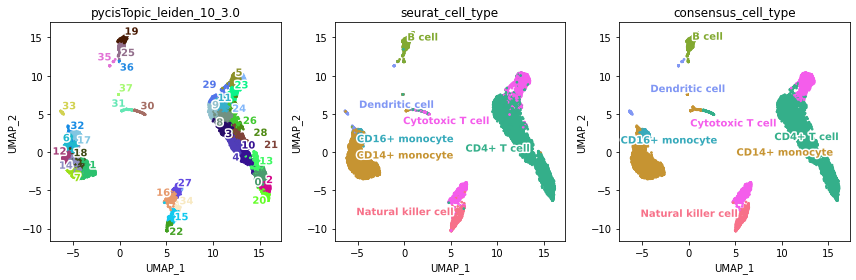

dumped_cto
UCS_ddseq_1.FIXEDCELLS


,cluster,major_cell_type,frac_of_cluster,next_celltype,next_frac_of_cluster,diff_to_next,cluster_counts
UCS_ddseq_1.FIXEDCELLS__22,22,CD4+ T cell,0.460177,Cytotoxic T cell,0.451327,0.00885,113
UCS_ddseq_1.FIXEDCELLS__18,18,Cytotoxic T cell,0.491803,CD4+ T cell,0.459016,0.032787,122
UCS_ddseq_1.FIXEDCELLS__1,1,Cytotoxic T cell,0.526316,Natural killer cell,0.392344,0.133971,209
UCS_ddseq_1.FIXEDCELLS__35,35,Cytotoxic T cell,0.597015,CD14+ monocyte,0.402985,0.19403,67


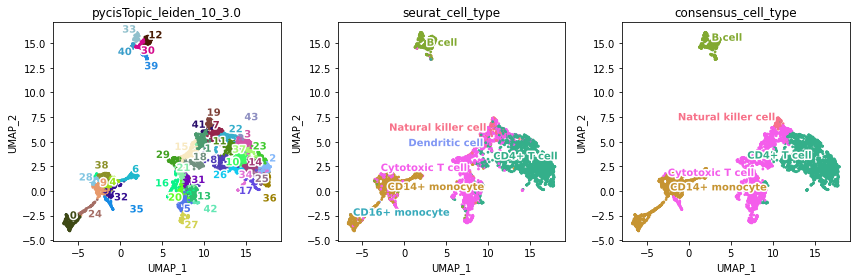

dumped_cto
UCS_ddseq_2.FIXEDCELLS


,cluster,major_cell_type,frac_of_cluster,next_celltype,next_frac_of_cluster,diff_to_next,cluster_counts
UCS_ddseq_2.FIXEDCELLS__35,35,CD14+ monocyte,0.305085,B cell,0.271186,0.033898,59
UCS_ddseq_2.FIXEDCELLS__38,38,Cytotoxic T cell,0.545455,CD4+ T cell,0.363636,0.181818,44
UCS_ddseq_2.FIXEDCELLS__20,20,Cytotoxic T cell,0.54,CD14+ monocyte,0.46,0.08,100
UCS_ddseq_2.FIXEDCELLS__41,41,Cytotoxic T cell,0.55,CD14+ monocyte,0.45,0.1,40


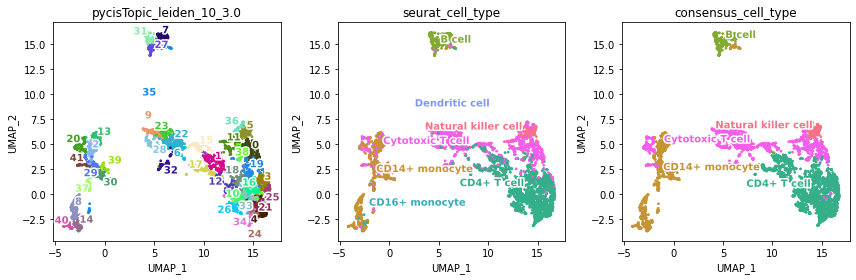

dumped_cto
cistopic_objects/VIB_10xmultiome_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


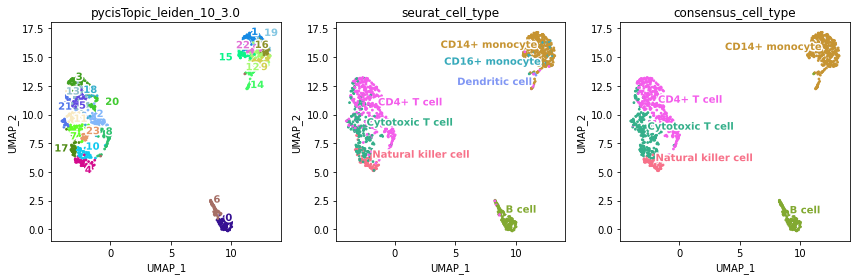

cistopic_objects/VIB_10xmultiome_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


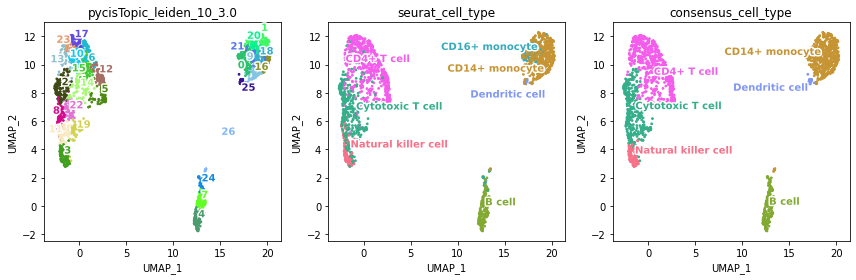

cistopic_objects/VIB_10xv1_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_7topics.dimreduc.consensus.pkl already exists!


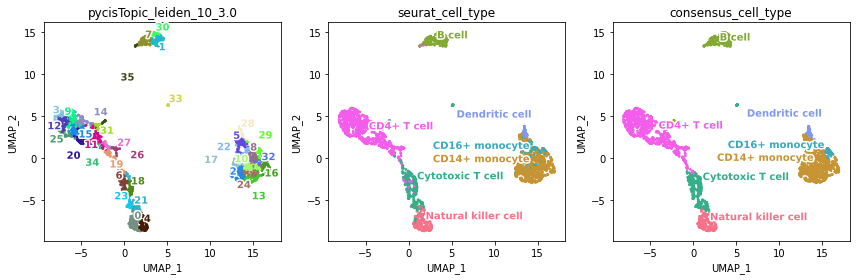

cistopic_objects/VIB_10xv1_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


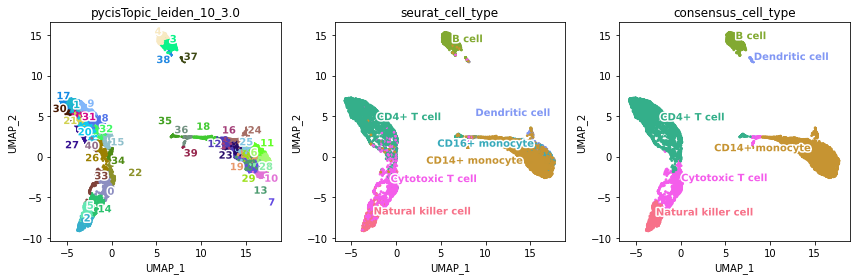

cistopic_objects/VIB_10xv2_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


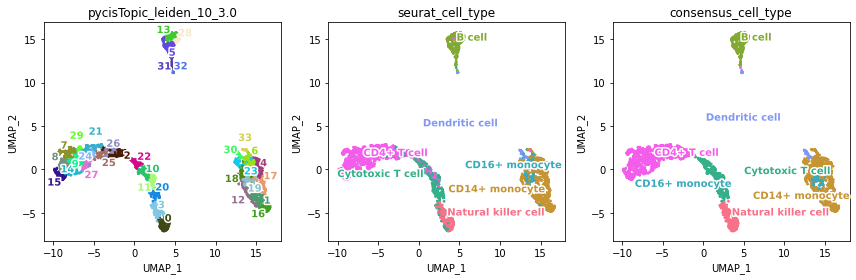

cistopic_objects/VIB_10xv2_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


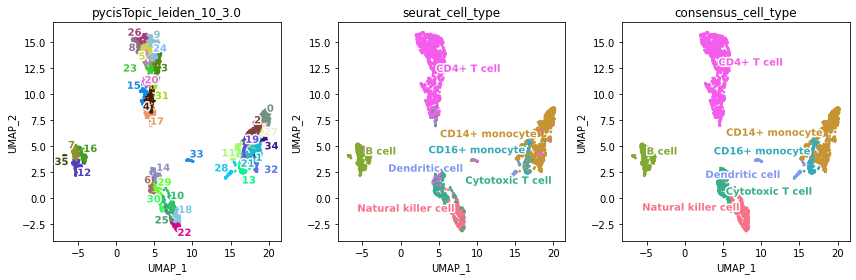

cistopic_objects/VIB_hydrop_1.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_11topics.dimreduc.consensus.pkl already exists!


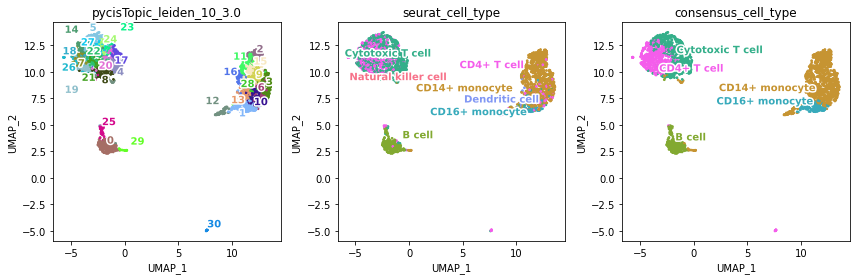

cistopic_objects/VIB_hydrop_11.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


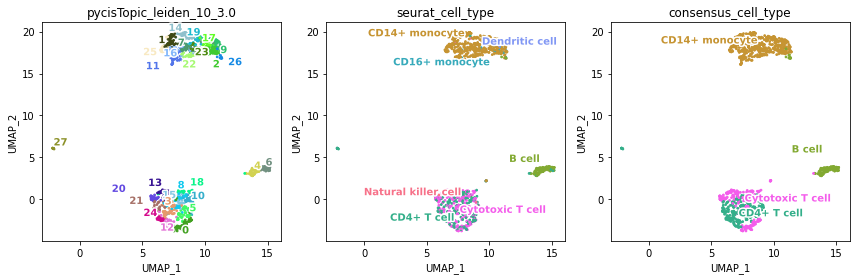

cistopic_objects/VIB_hydrop_12.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_10topics.dimreduc.consensus.pkl already exists!


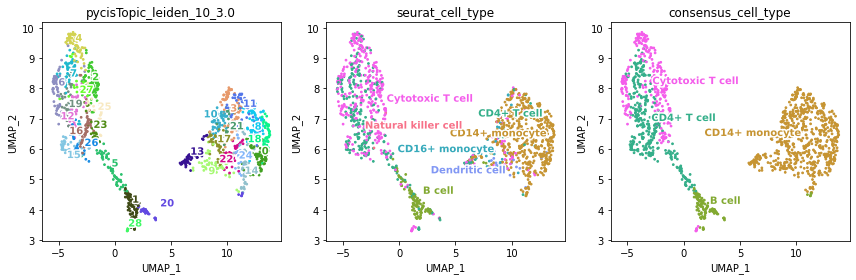

cistopic_objects/VIB_hydrop_2.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_8topics.dimreduc.consensus.pkl already exists!


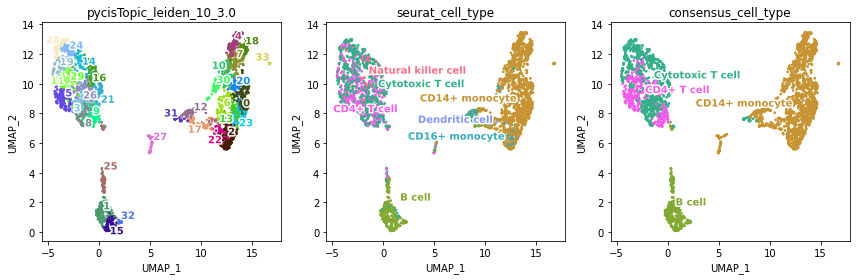

cistopic_objects/VIB_hydrop_21.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_12topics.dimreduc.consensus.pkl already exists!


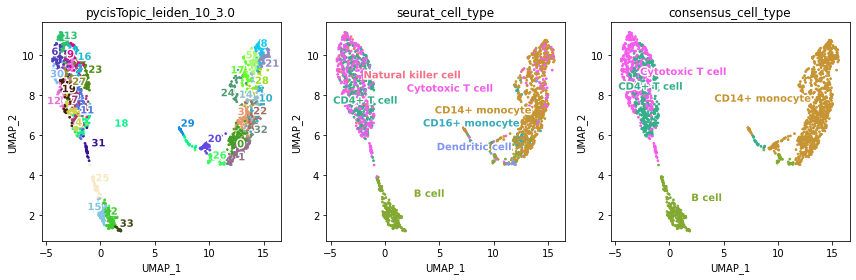

cistopic_objects/VIB_hydrop_22.FIXEDCELLS__cto.scrublet0-4.fmx.singlets.model_9topics.dimreduc.consensus.pkl already exists!


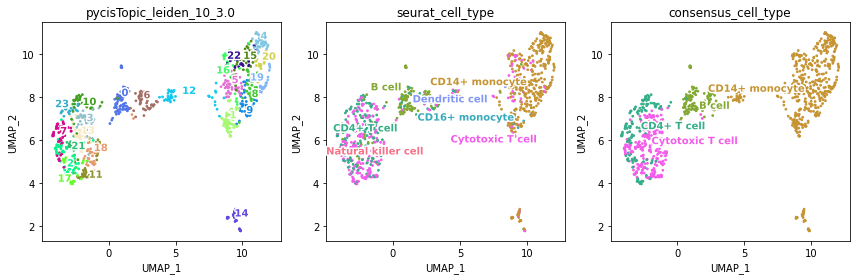

In [10]:
clustering='pycisTopic_leiden_10_3.0'
ct_pred_thr=0.7

to_plot = [clustering, 'seurat_cell_type', "consensus_cell_type"]
n_to_plot = len(to_plot)
n_cols = 3
n_rows = math.ceil(n_to_plot/n_cols)

clust_consensus = []
write = True
# for sample in ["BRO_mtscatac_1.LIBDS"]:
for sample in cto_model_path_dict.keys():
    cto_path = cto_model_path_dict[sample]
    cto_path_new = cto_path.replace(".pkl", ".consensus.pkl")
    if not os.path.exists(cto_path_new):
        with open(cto_path, 'rb') as f:
            cto = pickle.load(f)
        
        major_cell_type = []
        frac_of_cluster = []
        next_celltype = []
        next_frac_of_cluster = []
        diff_to_next = []
        
        celldata = cto.cell_data
        
        for c in celldata[clustering].unique():
            c1 = celldata[celldata[clustering]==c]
            # find proportions of each unique cell type detected in this cluster:
            ctp = pd.DataFrame([
                c1['seurat_cell_type'].unique(),
                [ c1[c1['seurat_cell_type']==x].shape[0] / c1.shape[0] for x in c1['seurat_cell_type'].unique() ]
            ]).T
            # sort/rank by proportion:
            ctps = ctp.sort_values(1,ascending=False)
            if ctp.shape[0]>1:
                n = ctps.iloc[1,0] # next cell type detected
                dtn = ctps.iloc[0,1] - ctps.iloc[1,1] # distance to next
                dtnf = ctps.iloc[1,1]
            else:
                dtn = None
                dtnf = None
                n = None
            major_cell_type.append(ctps.iloc[0,0])
            frac_of_cluster.append(ctps.iloc[0,1])
            next_celltype.append(n)
            next_frac_of_cluster.append(dtnf)
            diff_to_next.append(dtn)

        # collect results for this sample
        clust_consensus = pd.DataFrame([
                celldata[clustering].unique(),
                major_cell_type,
                frac_of_cluster,
                next_celltype,
                next_frac_of_cluster,
                diff_to_next,
            ]).T.set_axis(
                ['cluster', 'major_cell_type', 'frac_of_cluster', 
                 'next_celltype', 'next_frac_of_cluster', 'diff_to_next'],
                axis=1
            ).set_index(sample + '__' + celldata[clustering].unique())
        print(sample)
        clust_consensus['cluster_counts'] = clust_consensus['cluster'].map(celldata[clustering].value_counts())
        # print only rows where there is another cell type within 20%:
        if(sum(clust_consensus['diff_to_next']<0.20)>0):
            display(clust_consensus[ clust_consensus['diff_to_next']<0.20 ])
            
        else:
            print("No discrepant clusters")
            
        # add the mapping
        cto.cell_data['consensus_cell_type'] = ""
        for i,r in clust_consensus.iterrows():
            ix = cto.cell_data[clustering] == r['cluster']
            cto.cell_data.loc[ix,'consensus_cell_type'] = r['major_cell_type']
        
        plot_metadata(cto,
                      reduction_name='UMAP',
                      variables=to_plot,
                      target='cell',
                      num_columns=n_cols,
                      text_size=10,
                      dot_size=3,
                      figsize=(n_cols*4,n_rows*4),
                      save=f'plots_qc/{sample}__consensus_clusters_qc.png',
                      color_dictionary=palette_dict
                     )
        
        if write == True:
            with open(cto_path_new, 'wb') as f:
                pickle.dump(cto, f)
            print("dumped_cto")
    else:
        print(f'{cto_path_new} already exists!')
        display(Image(f'plots_qc/{sample}__consensus_clusters_qc.png'))
